# Big Data Analytics project - Group 04

This work was developed by:

- Daniel Caridade (20211588)
- Gonçalo Teles (20211684)
- Gonçalo Peres (20211625)
- Guilherme Godinho (20211552)
- Vinicius Pinto (20211682)

To run this notebook, our group recommends the usage of a cluster that is one of those available in the Standard catalogue, as ML clusters for the code provided can take more time than the Standard cluster options.

# 1. Library Importation

__`Step 1`__ Load the required libraries into Databricks

In [0]:
# Create Spark Session
from pyspark.sql import SparkSession

# Data Understanding 
from pyspark.sql import functions as F
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import plotly.express as px

# Data Preparation
from pyspark.sql import DataFrame
from itertools import chain
from pyspark.sql.window import Window
from pyspark.ml.stat import Correlation
from pyspark.ml.feature import VectorAssembler, RobustScaler,  Normalizer
from pyspark.ml import Pipeline
from pyspark.ml.functions import vector_to_array

# Modelling
from pyspark.ml.clustering import KMeans
from pyspark.ml.evaluation import ClusteringEvaluator
from sklearn.manifold import TSNE
from sklearn.metrics import pairwise_distances
from collections import Counter

# Streaming 
import time
import traceback
import random
import datetime
from pyspark.sql.functions import lit, current_timestamp
from pyspark.sql.types import DateType


# 2. Data Understanding

## 2.1. Data Integration

__`Step 2`__ Start the Spark Session

In [0]:
spark = SparkSession.builder.appName("BDA_Project").getOrCreate()

__`Step 3`__ Load the dataset.

In [0]:
# File location and type
file_location = "/FileStore/tables/Sales_Transaction_v_4a.csv"
file_type = "csv"

# CSV options
infer_schema = "true"
first_row_is_header = "true"
delimiter = ","

# The applied options are for CSV files. For other file types, these will be ignored.
df = spark.read.format(file_type) \
  .option("inferSchema", infer_schema) \
  .option("header", first_row_is_header) \
  .option("sep", delimiter) \
  .load(file_location)

display(df)

TransactionNo,Date,ProductNo,ProductName,Price,Quantity,CustomerNo,Country
581482,2019-12-09,22485,Set Of 2 Wooden Market Crates,21.47,12,17490,United Kingdom
581475,2019-12-09,22596,Christmas Star Wish List Chalkboard,10.65,36,13069,United Kingdom
581475,2019-12-09,23235,Storage Tin Vintage Leaf,11.53,12,13069,United Kingdom
581475,2019-12-09,23272,Tree T-Light Holder Willie Winkie,10.65,12,13069,United Kingdom
581475,2019-12-09,23239,Set Of 4 Knick Knack Tins Poppies,11.94,6,13069,United Kingdom
581475,2019-12-09,21705,Bag 500g Swirly Marbles,10.65,24,13069,United Kingdom
581475,2019-12-09,22118,Joy Wooden Block Letters,11.53,18,13069,United Kingdom
581475,2019-12-09,22119,Peace Wooden Block Letters,12.25,12,13069,United Kingdom
581475,2019-12-09,22217,T-Light Holder Hanging Lace,10.65,12,13069,United Kingdom
581475,2019-12-09,22216,T-Light Holder White Lace,10.55,24,13069,United Kingdom


## 2.2. Data Description

The dataset contains data of an UK online E-Commerce store from December of 2018 to December of 2019 and contains the following variables:

- `TransactionNo`: ID of the transaction.
- `Date`: Date of the purchase.
- `ProductNo`: ID of the product that was purchased.
- `ProductName`: Name of the product that was purchased.
- `Price`: The price of each product per unit in pound sterling (£).
- `Quantity`: The quantity of each product per transaction. Negative values are related to cancelled transactions.
- `CustomerNo`: ID of the customer that made the purchase. 
- `Country`: Name of the country where the customer resides.

## 2.3. Data Content

__`Step 4`__ Checking the dimensionality of the dataset (number of rows and columns).

In [0]:
(df.count(), len(df.columns))

Out[4]: (536350, 8)

__`Step 5`__ Checking the type of features and non-missing observations.

In [0]:
# Print a message before viewing the schema
print("Viewing schema (data types of features):")
df.printSchema()

# Print a message before counting non-missing values
print("\nViewing the number of non-missing (non-null) values per column:")
display(df.select([F.count(F.col(c)).alias(c) for c in df.columns]))

Viewing schema (data types of features):
root
 |-- TransactionNo: string (nullable = true)
 |-- Date: date (nullable = true)
 |-- ProductNo: string (nullable = true)
 |-- ProductName: string (nullable = true)
 |-- Price: double (nullable = true)
 |-- Quantity: integer (nullable = true)
 |-- CustomerNo: string (nullable = true)
 |-- Country: string (nullable = true)


Viewing the number of non-missing (non-null) values per column:


TransactionNo,Date,ProductNo,ProductName,Price,Quantity,CustomerNo,Country
536350,536350,536350,536350,536350,536350,536350,536350


Up to this point, we have been able to identify several key patterns and insights in the dataset:

- **Data Dimensionality:** The dataset contains **536,350 rows** and **8 columns**, which is expected for transactional data. Such data typically involves a high volume of observations (transactions) but relatively few features. This structure aligns well with our goal of building a recommender system, where patterns across many transactions are more valuable than a wide feature set.

- **Variable Types and Interpretation:** Databricks has correctly inferred the data types of each column. Notably, although variables such as *Product ID*, *Client ID*, and *Transaction Number* are expressed numerically, they have been appropriately treated as categorical (string-like) variables.

- **Missing Data:** It seems there is **no missing values** in the dataset. This eliminates the need, at this stage, for imputation techniques or handling missingness.

## 2.3. Descriptive Statistics

__`Step 6`__ Checking the descriptive statistics of the features.

In [0]:
display(df.describe())

summary,TransactionNo,ProductNo,ProductName,Price,Quantity,CustomerNo,Country
count,536350,536350,536350,536350,536350,536350,536350
mean,559978.9296258752,27501.334602703962,null,12.662182287685555,9.919347441036637,15227.893178194838,null
stddev,13434.267079561127,16621.547250098916,null,8.490450200816955,216.66229978945927,1716.5829320559192,null
min,536365,10002,"""Assorted Flower Colour """"Leis""""""",5.13,-80995,12004,Australia
max,C581569,90214Z,Zinc Wire Sweetheart Letter Tray,660.62,80995,NA,Unspecified


__`Step 7`__ Checking the number of unique values for each column of the dataset.

In [0]:
unique_counts = df.select([F.countDistinct(c).alias(c) for c in df.columns])
print("Number of unique values per column:")
display(unique_counts)

Number of unique values per column:


TransactionNo,Date,ProductNo,ProductName,Price,Quantity,CustomerNo,Country
23204,305,3768,3768,530,510,4739,38


__`Step 8`__ Checking what is the first date of transactions and the last one.

In [0]:
display(df.select(
    F.min("Date").alias("Earliest Date"),
    F.max("Date").alias("Latest Date")
))

Earliest Date,Latest Date
2018-12-01,2019-12-09


__`Step 9`__ Checking if there are actually missing values but expressed as NA in string format.

In [0]:
# Check for rows where CustomerNo is 'NA'
na_customerno = df.filter(F.col("CustomerNo") == 'NA').count()

print(f"🚨 Number of 'NA' values in 'CustomerNo': {na_customerno}")

🚨 Number of 'NA' values in 'CustomerNo': 55


From this analysis we can conlclude the following:

- There is a presence of some C values in at least one of the transaction (e.g. C581569), so there is a need to inspet if there are no incoherences in the data, or if C have a meaning that is underlining in the data.
- There is a presence of letters in the product number which shouldn't be expected.
- The prices of the products vary a lot from the minimum of 5.13£ up to the price of 660.52£. On average the price of products is 12.66£.
- The quantity of the products purchased vary from -80995 to 80995, with negative values meaning purchases that were cancelled, those type of transactions need to be accounted for as we don't want to input in our recommender system transactions that represent cancelled purchases, since they did not get any return to the E-Commerce platform.
- The is a total of 23204 transactions in the dataset.
- The dataset contains transactions from 01-12-2018 to 09-12-2019.
- The total number of distinct products in the company are 3768.
- There are 530 distinct prices and in the transactions there were 510 distinct quantities that were purchased.
- The dataset contains 4738 customers comming from 38 different countries. 

## 2.4. Missing values analysis

__`Step 10`__ Checking the transactions that have the `CustomerNo` equal to NA.

In [0]:
# Filter transactions where CustomerNo is 'NA'
transactions_na_customers = df.filter(F.col("CustomerNo") == 'NA')

# Show these transactions
display(transactions_na_customers)

# Optional: Count how many there are
print(f"🔍 Total transactions with 'CustomerNo' = 'NA': {transactions_na_customers.count()}")

TransactionNo,Date,ProductNo,ProductName,Price,Quantity,CustomerNo,Country
C581406,2019-12-08,46000M,Polyester Filler Pad 45x45cm,6.19,-240,NA,United Kingdom
C581406,2019-12-08,46000S,Polyester Filler Pad 40x40cm,6.19,-300,NA,United Kingdom
C575153,2019-11-08,22947,Wooden Advent Calendar Red,44.25,-1,NA,United Kingdom
C574288,2019-11-03,22178,Victorian Glass Hanging T-Light,25.37,-1,NA,United Kingdom
C573180,2019-10-28,23048,Set Of 10 Lanterns Fairy Light Star,14.5,-1,NA,United Kingdom
C569495,2019-10-04,21843,Red Retrospot Cake Stand,21.47,-1,NA,United Kingdom
C567518,2019-09-20,22846,Bread Bin Diner Style Red,27.62,-1,NA,United Kingdom
C567518,2019-09-20,21871,Save The Planet Mug,11.94,-12,NA,United Kingdom
C563015,2019-08-11,46000M,Polyester Filler Pad 45x45cm,10.25,-160,NA,United Kingdom
C563015,2019-08-11,46000S,Polyester Filler Pad 40x40cm,10.25,-220,NA,United Kingdom


🔍 Total transactions with 'CustomerNo' = 'NA': 55


All the transactions except one whose `CustomerNo` is missing are customers that represent cancelled transactions.

Aditionally, as there are not many missing rows they can be removed.

__`Step 10.1`__ Checking if the transaction that is not regarding cancelled purchases has more products and probably an associated `CustomerNo`.

In [0]:
# Filter by specific TransactionNo
display(df.filter(F.col("TransactionNo") == '558245'))

TransactionNo,Date,ProductNo,ProductName,Price,Quantity,CustomerNo,Country
558245,2019-06-27,22734,Set Of 6 Ribbons Vintage Christmas,10.25,8,NA,United Kingdom


There are no more informations about the customer who did this order, since the only item it bought was the `Set of 6 Ribbons Vintage Christmas`, so there is no easy way to guess who this customer is. Nonetheless, as this only represents 1 transaction, removing it is not very harmful for the analysis, since we are still left with the other 23203 transactions that will be left on the dataset.

## 2.5. Incoherences

__`Step 11`__ Checking if there are duplicated rows in the dataset.

In [0]:
# Group by all columns and count how many times each appears
duplicates_df = (
    df.groupBy(df.columns)
      .count()
      .filter(F.col("count") > 1)
)

# Show the duplicates
display(duplicates_df)
print(f'Number of duplicates: {duplicates_df.count()}')

TransactionNo,Date,ProductNo,ProductName,Price,Quantity,CustomerNo,Country,count
580399,2019-12-04,22483,Red Gingham Teddy Bear,6.19,1,13471,United Kingdom,2
580305,2019-12-02,84051,Ass Colour Glowing Tiaras,6.19,1,12970,United Kingdom,2
577482,2019-11-20,23269,Set Of 2 Ceramic Christmas Trees,11.74,6,16762,United Kingdom,2
577696,2019-11-21,84029G,Knitted Union Flag Hot Water Bottle,14.61,1,16406,United Kingdom,2
578678,2019-11-24,23210,White Rocking Horse Hand Painted,7.24,1,17841,United Kingdom,2
581405,2019-12-08,22500,Set Of 2 Tins Jardin De Provence,6.19,1,13521,United Kingdom,2
581142,2019-12-07,22906,12 Message Cards With Envelopes,6.19,1,14204,United Kingdom,2
580523,2019-12-04,22086,Paper Chain Kit 50'S Christmas,6.19,1,17827,United Kingdom,2
579161,2019-11-28,23309,Set Of 60 I Love London Cake Cases,6.19,1,17379,United Kingdom,2
578935,2019-11-27,23333,Ivory Wicker Heart Medium,6.19,1,15351,United Kingdom,2


Number of duplicates: 4794


__`Step 12`__ Checking how many transactions have letters in them.

In [0]:
# Filter rows where TransactionNo contains any letter (a-z or A-Z)
df_with_letters = df.filter(F.col("TransactionNo").rlike("[A-Za-z]"))

print("🧾 Transactions that contain letters in their TransactionNo:")
display(df_with_letters)

count_with_letters = df_with_letters.count()
print(f"🔢 Number of transactions with letters in the TransactionNo: {count_with_letters}")

🧾 Transactions that contain letters in their TransactionNo:


TransactionNo,Date,ProductNo,ProductName,Price,Quantity,CustomerNo,Country
C581484,2019-12-09,23843,Paper Craft Little Birdie,6.19,-80995,16446,United Kingdom
C581490,2019-12-09,22178,Victorian Glass Hanging T-Light,6.19,-12,14397,United Kingdom
C581490,2019-12-09,23144,Zinc T-Light Holder Stars Small,6.04,-11,14397,United Kingdom
C581568,2019-12-09,21258,Victorian Sewing Box Large,6.19,-5,15311,United Kingdom
C581569,2019-12-09,84978,Hanging Heart Jar T-Light Holder,6.19,-1,17315,United Kingdom
C581569,2019-12-09,20979,36 Pencils Tube Red Retrospot,6.19,-5,17315,United Kingdom
C581228,2019-12-08,22423,Regency Cakestand 3 Tier,6.19,-6,16019,United Kingdom
C581228,2019-12-08,23210,White Rocking Horse Hand Painted,6.19,-12,16019,United Kingdom
C581228,2019-12-08,82494L,Wooden Frame Antique White,6.19,-6,16019,United Kingdom
C581228,2019-12-08,22781,Gumball Magazine Rack,6.19,-24,16019,United Kingdom


🔢 Number of transactions with letters in the TransactionNo: 8585


__`Step 12.1`__ Checking the letters that are present in the transaction number. 

In [0]:
# Extract letters from the TransactionNo field
df_letters = df.withColumn("LettersInTransactionNo", F.regexp_extract("TransactionNo", "([A-Za-z]+)", 1))

# Filter rows where letters were found
df_letters_filtered = df_letters.filter(F.col("LettersInTransactionNo") != "")

# Display the letters that are present in the ID's
display(df_letters_filtered.select("LettersInTransactionNo").distinct())

LettersInTransactionNo
C


From analysing the dataset and the metadata we understood that the presence of the C in the `TransactionNo` corresponds to transactions that were cancelled.

__`Step 12.2`__ Checking if there are positive quantities in transactions that represent cancelled purchases.

In [0]:
# Filter for transactions where TransactionNo starts with 'C' and Quantity >= 0
cancelled_with_non_negative_qty = df.filter(
    (F.col("TransactionNo").startswith("C")) & (F.col("Quantity") >= 0)
)

# Show the results
cancelled_with_non_negative_qty.show(truncate=False)

# Count how many such cases exist
count_invalid_cancelled = cancelled_with_non_negative_qty.count()
print(f"❗ Number of cancelled transactions with non-negative quantities: {count_invalid_cancelled}")

+-------------+----+---------+-----------+-----+--------+----------+-------+
|TransactionNo|Date|ProductNo|ProductName|Price|Quantity|CustomerNo|Country|
+-------------+----+---------+-----------+-----+--------+----------+-------+
+-------------+----+---------+-----------+-----+--------+----------+-------+

❗ Number of cancelled transactions with non-negative quantities: 0


__`Step 12.3`__ Checking if there are transactions that represent non-cancelled purchases with negative numbers.

In [0]:
# Filter for transactions where TransactionNo does NOT start with 'C' and Quantity < 0
non_cancelled_with_negative_qty = df.filter(
    (~F.col("TransactionNo").startswith("C")) & (F.col("Quantity") < 0)
)

# Show the results
non_cancelled_with_negative_qty.show(truncate=False)

# Count how many such cases exist
count_invalid_non_cancelled = non_cancelled_with_negative_qty.count()
print(f"❗ Number of non-cancelled transactions with negative quantities: {count_invalid_non_cancelled}")

+-------------+----+---------+-----------+-----+--------+----------+-------+
|TransactionNo|Date|ProductNo|ProductName|Price|Quantity|CustomerNo|Country|
+-------------+----+---------+-----------+-----+--------+----------+-------+
+-------------+----+---------+-----------+-----+--------+----------+-------+

❗ Number of non-cancelled transactions with negative quantities: 0


__`Step 13`__ Checking the products with `ProductNo` that have a letter in it.

In [0]:
# Step 1: Filter rows where ProductNo contains any letter (a–z or A–Z)
df_prod_letters = df.filter(F.col("ProductNo").rlike("[A-Za-z]"))

# Step 2: Count how many rows match
count_prod_letters = df_prod_letters.count()
print(f"🔢 Number of rows with letters in ProductNo: {count_prod_letters}")

# Step 3: Show a sample of those rows (or all, if you prefer)
display(df_prod_letters)

# Optional: if you just want the distinct ProductNos that contain letters
distinct_prod_letters = df_prod_letters.select("ProductNo").distinct()
print(f"🎯 Distinct ProductNos containing letters ({distinct_prod_letters.count()} total):")

🔢 Number of rows with letters in ProductNo: 50921


TransactionNo,Date,ProductNo,ProductName,Price,Quantity,CustomerNo,Country
581476,2019-12-09,84596F,Small Marshmallows Pink Bowl,10.68,32,12433,Norway
581476,2019-12-09,84596B,Small Dolly Mix Design Orange Bowl,10.68,16,12433,Norway
581476,2019-12-09,84510A,Set Of 4 English Rose Coasters,11.53,20,12433,Norway
581476,2019-12-09,47559B,Tea Time Oven Glove,11.53,10,12433,Norway
581476,2019-12-09,47504H,English Rose Spirit Level,11.06,36,12433,Norway
581477,2019-12-09,84970L,Single Heart Zinc T-Light Holder,11.53,12,13426,United Kingdom
581478,2019-12-09,84997C,Childrens Cutlery Polkadot Blue,14.5,4,17364,United Kingdom
581478,2019-12-09,84997D,Childrens Cutlery Polkadot Pink,14.5,4,17364,United Kingdom
581480,2019-12-09,84029E,Red Woolly Hottie White Heart,14.61,8,14441,United Kingdom
581480,2019-12-09,84029G,Knitted Union Flag Hot Water Bottle,14.61,12,14441,United Kingdom


🎯 Distinct ProductNos containing letters (912 total):


From this query we are capable of understanding that there are a lot of rows and products that have a letter assigned to it indicating that this presence of letters in the `ProductNo` seems to be a normal cataloguing behaviour for the company and for that reason we will investigate a bit further if there are incoherences otherwise we will leave it as it is.

__`Step 13.1`__ Checking if there are products that have more than 1 `ProductNo`.

In [0]:
# Group by ProductName and count distinct ProductNo
product_name_multiple_codes = df.groupBy("ProductName") \
    .agg(F.countDistinct("ProductNo").alias("DistinctProductNoCount")) \
    .filter(F.col("DistinctProductNoCount") >= 2)

# Show the results
product_name_multiple_codes.show(truncate=False)

# Print total number of such product names
count_multiple = product_name_multiple_codes.count()
print(f"🔍 Number of product names with 2 or more distinct ProductNo values: {count_multiple}")

+-----------+----------------------+
|ProductName|DistinctProductNoCount|
+-----------+----------------------+
+-----------+----------------------+

🔍 Number of product names with 2 or more distinct ProductNo values: 0


__`Step 13.2`__ Checking if there are products that have very similar names.

In [0]:
# Step 1: Get the list of product names and their ProductNo
product_names = df.select("ProductName", "ProductNo").distinct()

# Step 2: Self-join the DataFrame to compare each ProductName with all others
product_pairs = product_names.alias('a').join(
    product_names.alias('b'),
    F.col('a.ProductNo') != F.col('b.ProductNo'),  # Avoid comparing the same product with itself
    how='inner'
)

# Step 3: Calculate the Levenshtein distance between product names
product_pairs = product_pairs.withColumn(
    'levenshtein_distance',
    F.levenshtein(F.col('a.ProductName'), F.col('b.ProductName'))
)

# Step 4: Filter for product pairs with a small Levenshtein distance (indicating similarity)
similar_products = product_pairs.filter(F.col('levenshtein_distance') < 5)

# Step 5: Show the result with product pairs that have similar names
display(similar_products)

# Step 6: Count how many such pairs exist
count_similar_pairs = similar_products.count()
print(f"🔢 Number of similar product pairs found: {count_similar_pairs}")

ProductName,ProductNo,ProductName,ProductNo,levenshtein_distance
Red Retrospot Shopper Bag,20718,Red Retrospot Shopping Bag,21039,3
Red Diner Wall Clock,22193,Pink Diner Wall Clock,23341,4
Red Diner Wall Clock,22193,Mint Diner Wall Clock,23342,4
Red Diner Wall Clock,22193,Blue Diner Wall Clock,22192,4
Assorted Tutti Frutti Fob Notebook,21640,Assorted Tutti Frutti Notebook,21638,4
Childs Garden Rake Blue,22516,Childs Garden Rake Pink,22517,4
Childs Garden Rake Blue,22516,Childs Garden Fork Blue,22522,4
Childs Garden Rake Blue,22516,Childs Garden Spade Blue,22514,3
Wrap Wedding Day,22709,Card Wedding Day,22715,4
Beaded Crystal Heart Blue Large,85130C,Beaded Crystal Heart Green Large,85130B,4


🔢 Number of similar product pairs found: 1944


By analysing the table above no incoherences in the names were found.

__`Step 14`__ Checking if there are `CustomerNo` with letters in it.

In [0]:
# Filter rows where CustomerNo contains any letter
df_customers_with_letters = df.filter(F.col("CustomerNo").rlike("[A-Za-z]"))

# Show the results
display(df_customers_with_letters)

# Count how many such rows exist
count_customers_with_letters = df_customers_with_letters.count()
print(f"🔠 Number of CustomerNo values that contain letters: {count_customers_with_letters}")

TransactionNo,Date,ProductNo,ProductName,Price,Quantity,CustomerNo,Country
C581406,2019-12-08,46000M,Polyester Filler Pad 45x45cm,6.19,-240,NA,United Kingdom
C581406,2019-12-08,46000S,Polyester Filler Pad 40x40cm,6.19,-300,NA,United Kingdom
C575153,2019-11-08,22947,Wooden Advent Calendar Red,44.25,-1,NA,United Kingdom
C574288,2019-11-03,22178,Victorian Glass Hanging T-Light,25.37,-1,NA,United Kingdom
C573180,2019-10-28,23048,Set Of 10 Lanterns Fairy Light Star,14.5,-1,NA,United Kingdom
C569495,2019-10-04,21843,Red Retrospot Cake Stand,21.47,-1,NA,United Kingdom
C567518,2019-09-20,22846,Bread Bin Diner Style Red,27.62,-1,NA,United Kingdom
C567518,2019-09-20,21871,Save The Planet Mug,11.94,-12,NA,United Kingdom
C563015,2019-08-11,46000M,Polyester Filler Pad 45x45cm,10.25,-160,NA,United Kingdom
C563015,2019-08-11,46000S,Polyester Filler Pad 40x40cm,10.25,-220,NA,United Kingdom


🔠 Number of CustomerNo values that contain letters: 55


The only letters that exist in the `CustomerNo` feature are the missing values that are expressed as the string 'NA'.

__`Step 15`__ Checking for the unique country names to ensure all of them are valid countries.

In [0]:
# Group by country and count distinct CustomerNo for each
country_customer_counts = df.groupBy("Country") \
    .agg(F.countDistinct("CustomerNo").alias("DistinctCustomerCount")) \
    .orderBy("DistinctCustomerCount", ascending=False)

# Show all unique countries with their customer counts
display(country_customer_counts)

# Count how many unique countries there are
country_count = country_customer_counts.count()
print(f"🌍 Number of unique country names: {country_count}")

# Total unique customers in the full dataset
total_unique_customers = df.select("CustomerNo").distinct().count()
print(f"👥 Total unique customers in dataset: {total_unique_customers}")

# Sum of unique customers grouped by country
sum_of_country_customers = country_customer_counts.agg(
    F.sum("DistinctCustomerCount")
).collect()[0][0]
print(f"🧮 Sum of distinct customers from country breakdown: {sum_of_country_customers}")

Country,DistinctCustomerCount
United Kingdom,4325
Germany,92
France,87
Spain,23
Belgium,22
Switzerland,21
Portugal,18
EIRE,13
Finland,12
Italy,12


🌍 Number of unique country names: 38
👥 Total unique customers in dataset: 4739
🧮 Sum of distinct customers from country breakdown: 4739


**🌍 Country Names**

By analysing the code above we were capable of identifying some country names that are not standardized with nowadays country names, those are the following:

- **EIRE** – This is an older or alternative name for **Ireland**. For that reason it should be assigned the name Ireland to be easier to understand.
- **Channel Islands** – A group of islands under the British Crown; **not a country**. Nonetheless, we can keep them as they are to flag that those purchases were made by people of that territory.
- **RSA** – Stands for **Republic of South Africa**. It will be replaced with just `South Africa` so it is easier to understand.
- **Unspecified** – There are 7 rows with the value Unspecified, which presents us the fact that we do indeed have missing data in the Country information.
- **European Community** – Refers to a **political/economic union**, not a country. Nonetheless as it only represents 1 customer, we will not make the huge effort of trying to guess from which country that customer is.

__`Step 15.1`__ Checking if there are customers that were from a country in a specific transaction and then in another are from a different one.

In [0]:
# Find customers associated with more than one country
multi_country_customers = df.groupBy("CustomerNo") \
    .agg(F.countDistinct("Country").alias("CountryCount")) \
    .filter("CountryCount > 1")

# Join back to see their actual countries
customers_with_multiple_countries = df.join(
    multi_country_customers.select("CustomerNo"),
    on="CustomerNo",
    how="inner"
).select("CustomerNo", "Country").distinct().orderBy("CustomerNo")

# Show results
customers_with_multiple_countries.show(truncate=False)

# Count of such customers
num_multi_country_customers = multi_country_customers.count()
print(f"🔄 Number of customers with multiple countries: {num_multi_country_customers}")

+----------+-------+
|CustomerNo|Country|
+----------+-------+
+----------+-------+

🔄 Number of customers with multiple countries: 0


As there are no customers who have changed their country of residence (i.e., no customer has appeared with multiple countries in different transactions), it’s difficult to determine whether a customer listed under the `Unspecified` country label was originally from a specific country. 

Given this challenge, maintaining `Unspecified` as a distinct category will be our practical solution. This approach avoids introducing ambiguity or making assumptions about the true country of origin, especially when there’s no clear or reliable way to impute or assign a specific country.

## 2.6. Univariate Feature Analysis

__`Step 16`__ Checking the histogram and boxplot of our numeric features (Quantity and Price).

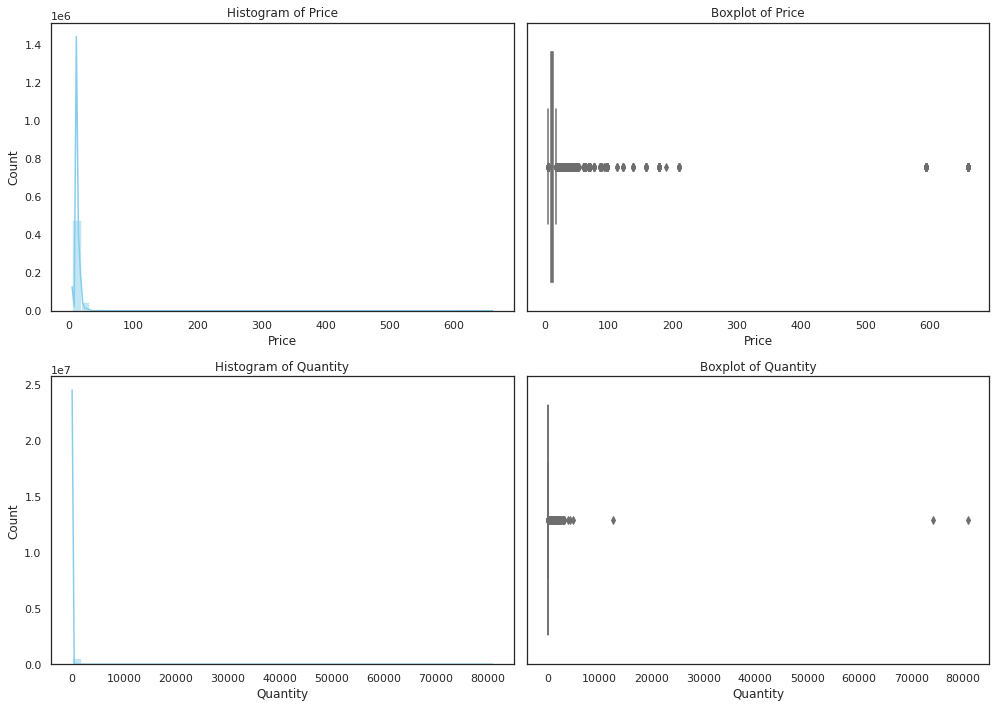

In [0]:
# Filter out negative Price and Quantity values
filtered_df = df.filter((df.Price >= 0) & (df.Quantity >= 0))

# Select the Price and Quantity columns and convert to Pandas
price_quantity_df = filtered_df.select("Price", "Quantity").toPandas()

# Set style for plots
sns.set(style="white")

# Create subplots: 2 rows (Price, Quantity), 2 columns (histogram, boxplot)
fig, axes = plt.subplots(2, 2, figsize=(14, 10))

# Histogram for Price
sns.histplot(price_quantity_df["Price"], bins=50, kde=True, ax=axes[0, 0], color='skyblue')
axes[0, 0].set_title("Histogram of Price")

# Boxplot for Price
sns.boxplot(x=price_quantity_df["Price"], ax=axes[0, 1], color='lightcoral')
axes[0, 1].set_title("Boxplot of Price")

# Histogram for Quantity
sns.histplot(price_quantity_df["Quantity"], bins=50, kde=True, ax=axes[1, 0], color='skyblue')
axes[1, 0].set_title("Histogram of Quantity")

# Boxplot for Quantity
sns.boxplot(x=price_quantity_df["Quantity"], ax=axes[1, 1], color='lightcoral')
axes[1, 1].set_title("Boxplot of Quantity")

# Adjust layout
plt.tight_layout()
plt.show()

By analysing the two graphs in the image we can see that both the quantity and the price are very skewed variables and present a lot of outliers, which need to be dealt with in case we might think on using them for any clustering algorithm.
For instance, features that we will create from these features for clustering are very likely to bring with them a lot of variables as due to the huge presence of outliers in the data.

__`Step 17`__ Plotting the number of customers per country with a bubble chart.

In [0]:
# Step 1: Group by Country and count distinct customers
country_client_counts = df.groupBy("Country") \
    .agg(F.countDistinct("CustomerNo").alias("CustomerCount"))

# Step 2: Convert to Pandas
country_client_df = country_client_counts.toPandas()

# Step 3: Fix country names if necessary
country_client_df["Country"] = country_client_df["Country"].replace({
    "EIRE": "Ireland",
    "RSA": "South Africa",
    "Channel Islands": "United Kingdom",
    "Unspecified": None,
    "European Community": None
})
country_client_df = country_client_df.dropna(subset=["Country"])

# Step 4: Create bubble map with fixed color (same as Code 2)
fig = px.scatter_geo(
    country_client_df,
    locations="Country",
    locationmode="country names",
    size="CustomerCount",
    color_discrete_sequence=["#FF1493"],
    projection="natural earth",
    title="🗺️ Bubble Map of Unique Customers per Country",
    size_max=40
)

fig.update_layout(
    geo=dict(showframe=False, showcoastlines=True, showcountries=True),
    margin={"r":0,"t":50,"l":0,"b":0}
)

fig.show()

From the visual, we can see that the companies sells majorily for European companies, serving in the vast majority their domestic market (UK), as the grand majority of the customers came reside in this country.

__`Step 18`__ Checking the top 15 most purchased products.

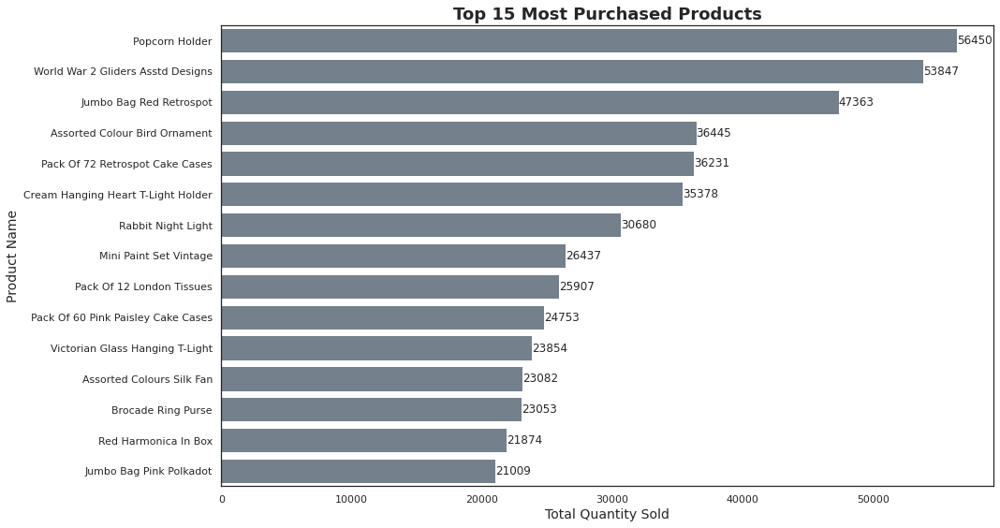

In [0]:
# Step 1: Group by ProductName and sum the Quantity
top_products = df.groupBy("ProductName") \
    .agg(F.sum("Quantity").alias("TotalQuantity")) \
    .orderBy(F.col("TotalQuantity").desc()) \
    .limit(15)

# Step 2: Convert to Pandas
top_products_pd = top_products.toPandas()

# Step 3: Sort values in descending order (for highest at the top in horizontal barplot)
top_products_pd = top_products_pd.sort_values("TotalQuantity", ascending=False)

# Step 4: Plot the result
plt.figure(figsize=(15, 8))
sns.set(style="white")

barplot = sns.barplot(
    data=top_products_pd,
    x="TotalQuantity",
    y="ProductName",
    color="slategray"
)

# Add value labels with a small gap from the bar
for i, qty in enumerate(top_products_pd["TotalQuantity"]):
    plt.text(qty + 1, i, f'{int(qty)}', va='center')  # added +10 padding

plt.title("Top 15 Most Purchased Products", fontsize=18, fontweight='bold')
plt.xlabel("Total Quantity Sold", fontsize=14)
plt.ylabel("Product Name", fontsize=14)
plt.tight_layout()
plt.show()

The top-selling product was the Popcorn Holder, with an impressive 56,450 units sold. It was followed closely by World War 2 Gliders – Assorted Designs, with 53,847 units, and the Jumbo Bag Red Retrospot, which secured third place with 47,363 units sold. These three items stand out significantly in customer purchasing behavior, indicating strong popularity and demand.

## 2.7. Multivariate Feature Analysis

__`Step 19`__ Plotting the evolution of the sales through the months.

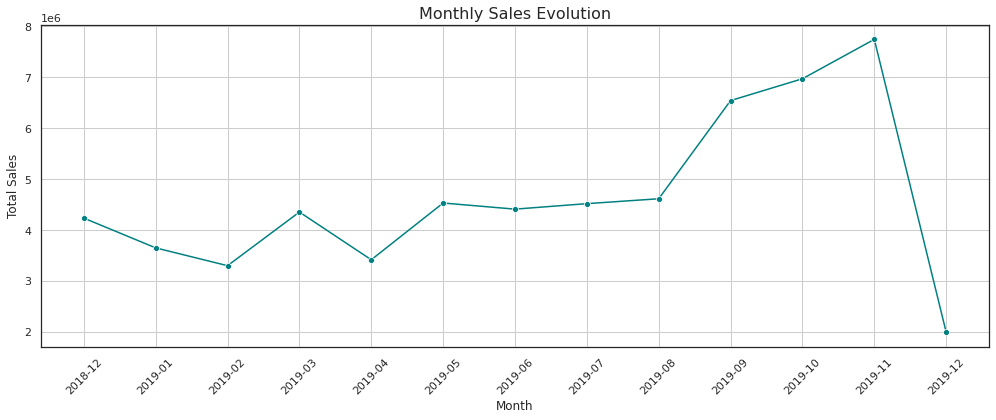

In [0]:
# Step 1: Create a copy of the dataset called data
data = df

# Step 2: Create a 'YearMonth' column for grouping (e.g., '2023-01')
data = data.withColumn("YearMonth", F.date_format(F.col("Date"), "yyyy-MM"))

# Step 2: Calculate total sales per transaction
data = data.withColumn("Sales", F.col("Price") * F.col("Quantity"))

# Step 3: Group by YearMonth and sum the sales
monthly_sales = data.groupBy("YearMonth") \
    .agg(F.sum("Sales").alias("TotalSales")) \
    .orderBy("YearMonth")

# Step 4: Convert to Pandas for plotting
monthly_sales_pd = monthly_sales.toPandas()

# Step 5: Plot the monthly sales
sns.set_style("white")

plt.figure(figsize=(14, 6))
sns.lineplot(data=monthly_sales_pd, x="YearMonth", y="TotalSales", marker="o", color="teal")
plt.title("Monthly Sales Evolution", fontsize=16)
plt.xlabel("Month")
plt.ylabel("Total Sales")
plt.xticks(rotation=45)
plt.grid(True)
plt.tight_layout()
plt.show()

The graph shows that the company maintained a relatively steady level of sales throughout the year, with a noticeable upward trend in recent months. Sales began to rise significantly from August, peaking in November. The subsequent drop in December is likely due to incomplete data for that month, rather than an actual decline in performance.

__`Step 20`__ Checking the evolution of the number of customers per month.

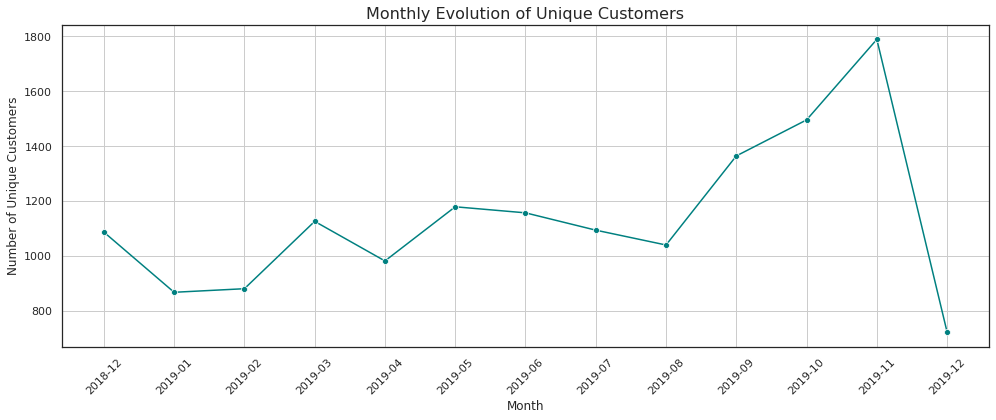

In [0]:
# Step 1: Count distinct customers per month
monthly_customers = data.groupBy("YearMonth") \
    .agg(F.countDistinct("CustomerNo").alias("UniqueCustomers")) \
    .orderBy("YearMonth")

# Step 2: Convert to Pandas for plotting
monthly_customers_pd = monthly_customers.toPandas()

# Step 3: Plot the result
plt.figure(figsize=(14, 6))
sns.lineplot(data=monthly_customers_pd, x="YearMonth", y="UniqueCustomers", marker="o", color="teal")
plt.title("Monthly Evolution of Unique Customers", fontsize=16)
plt.xlabel("Month")
plt.ylabel("Number of Unique Customers")
plt.xticks(rotation=45)
plt.grid(True)
plt.tight_layout()
plt.show()

The number of unique customers follows a trend similar to total sales, though with more fluctuations early in the year — particularly a noticeable increase in March followed by a dip in April. From August to November, there is a significant rise in customer numbers, which likely contributed to the surge in sales during that period.

__`Step 21`__ Checking the evolution of transactions per month.

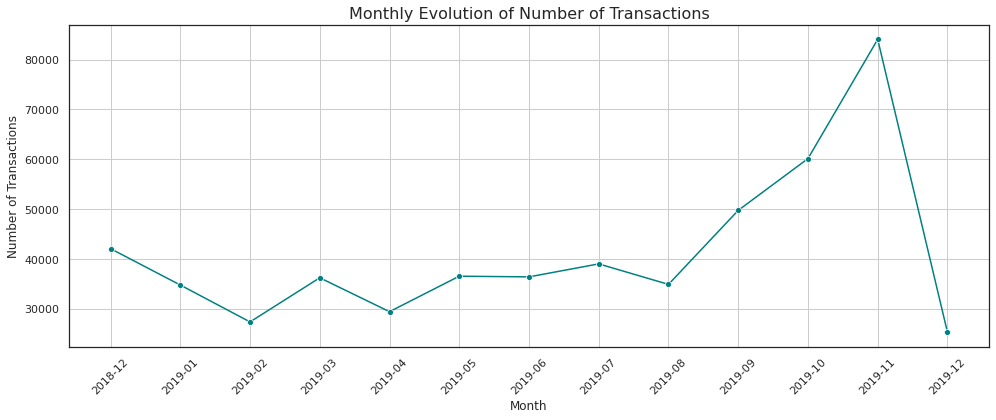

In [0]:
# Step 1: Count the number of transactions per month
monthly_transactions = data.groupBy("YearMonth") \
    .agg(F.count("TransactionNo").alias("NumberOfTransactions")) \
    .orderBy("YearMonth")

# Step 2: Convert to Pandas for plotting
monthly_transactions_pd = monthly_transactions.toPandas()

# Step 3: Plot the result
plt.figure(figsize=(14, 6))
sns.lineplot(data=monthly_transactions_pd, x="YearMonth", y="NumberOfTransactions", marker="o", color="teal")
plt.title("Monthly Evolution of Number of Transactions", fontsize=16)
plt.xlabel("Month")
plt.ylabel("Number of Transactions")
plt.xticks(rotation=45)
plt.grid(True)
plt.tight_layout()
plt.show()

The evolution of transactions closely mirrors the behavior of sales trends.

__`Step 22`__ Checking the evolution of the number of new customers that joined the company.

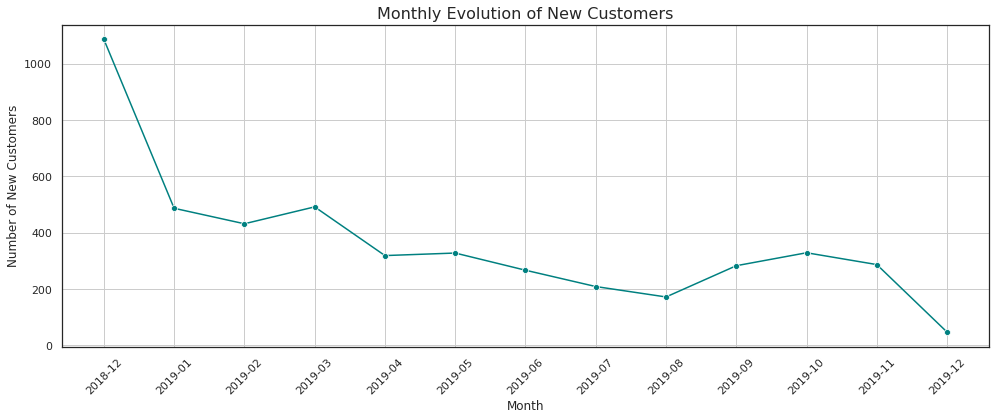

In [0]:
# Step 1: Find the first transaction month for each customer
first_transaction = data.groupBy("CustomerNo") \
    .agg(F.min("YearMonth").alias("FirstTransactionMonth"))

# Step 2: Count new customers per month
new_customers = first_transaction.groupBy("FirstTransactionMonth") \
    .agg(F.countDistinct("CustomerNo").alias("NewCustomers")) \
    .orderBy("FirstTransactionMonth")

# Step 3: Convert to Pandas for plotting
new_customers_pd = new_customers.toPandas()

# Step 4: Plot the result
plt.figure(figsize=(14, 6))
sns.lineplot(data=new_customers_pd, x="FirstTransactionMonth", y="NewCustomers", marker="o", color="teal")
plt.title("Monthly Evolution of New Customers", fontsize=16)
plt.xlabel("Month")
plt.ylabel("Number of New Customers")
plt.xticks(rotation=45)
plt.grid(True)
plt.tight_layout()
plt.show()

The evolution of the number of customers shows some distinct patterns compared to the other graphs. From January to March, there was an increase in the number of new customers joining the company, which explains the rise in unique customers making purchases from February to March. In April, however, there was a decrease in new customer acquisition, which corresponds with the drop in the number of unique customers who made purchases that month.

While the number of new customers gradually declined after April, it began to rise again from August to November. This increase aligns with the positive trends seen in the other graphs, highlighting a period in which the company successfully attracted more new customers and boosted purchases on its e-commerce platform.

__`Step 23`__ Checking which country gives us spends the most per capita in the E-Commerce platform.

In [0]:
# Step 1: Calculate total money spent by each customer
data = data.withColumn("TotalSpent", F.col("Price") * F.col("Quantity"))

# Step 2: Group by Country and calculate average money spent per customer
country_spending = data.groupBy("Country") \
    .agg(
        F.sum("TotalSpent").alias("TotalSpent"),
        F.countDistinct("CustomerNo").alias("CustomerCount")
    )

# Step 3: Calculate average money spent per customer (TotalSpent / CustomerCount)
country_spending = country_spending.withColumn(
    "AvgSpentPerCustomer", F.col("TotalSpent") / F.col("CustomerCount")
)

# Step 4: Convert to Pandas
country_spending_df = country_spending.toPandas()

# Step 5: Round the 'AvgSpentPerCustomer' to 2 decimal places
country_spending_df["AvgSpentPerCustomer"] = country_spending_df["AvgSpentPerCustomer"].round(2)

# Step 6: Fix country names if necessary (same as in your example)
country_spending_df["Country"] = country_spending_df["Country"].replace({
    "EIRE": "Ireland",
    "RSA": "South Africa",
    "Channel Islands": "United Kingdom",
    "Unspecified": None,
    "European Community": None
})

# Drop rows with missing or invalid countries
country_spending_df = country_spending_df.dropna(subset=["Country"])

# Step 7: Set a constant color (green) for all bubbles
fig = px.scatter_geo(
    country_spending_df,
    locations="Country",
    locationmode="country names",
    size="AvgSpentPerCustomer",
    color_discrete_sequence=["#FF1493"],  # Set the color to green
    projection="natural earth",
    title="🌍 Average Money Spent Per Customer by Country",
    size_max=40
)

fig.update_layout(
    geo=dict(showframe=False, showcoastlines=True, showcountries=True),
    margin={"r":0,"t":50,"l":0,"b":0}
)

fig.show()

Although the majority of customers are from the UK, the Netherlands leads in per capita spending, with an average of £238,645.71 per customer. Following closely is Ireland, where each customer spends an average of £127,741.93, and in third place is Australia, with an average spend of £109,861.82 per customer.

This data suggests that while the UK has the highest customer volume, other countries, particularly the Netherlands, are significantly outpacing the UK in terms of individual spending. The strong spending behavior observed in the Netherlands, Ireland, and Australia indicates potential opportunities for the company to tailor its strategies to further capitalize on high-value markets and perhaps explore more targeted marketing or product offerings in these regions.

# 3. Data Preparation

## 3.1. Solving Incoherences

__`Step 24`__ Creating a function to remove cancelled transactions as well as duplicated rows.

In [0]:
def clean_transactions(df: DataFrame) -> DataFrame:
    """
    Cleans the transactions DataFrame by:
    1. Removing rows where 'TransactionNo' starts with 'C' or 'c'.
    2. Removing duplicate rows, keeping only the first appearance.

    Parameters:
    - df (DataFrame): Transactions DataFrame with a 'TransactionNo'.

    Returns:
    - DataFrame: Cleaned DataFrame.
    """
    # Step 1: Remove rows where TransactionNo starts with 'C' or 'c'
    df_cleaned = df.filter(~F.col("TransactionNo").rlike("^[Cc]"))

    # Step 2: Remove duplicates based on all columns, keeping first appearance
    window_spec = Window.partitionBy(df.columns).orderBy(F.monotonically_increasing_id())
    df_cleaned = df_cleaned.withColumn("row_num", F.row_number().over(window_spec)) \
                           .filter(F.col("row_num") == 1) \
                           .drop("row_num")

    return df_cleaned

__`Step 25`__ Creating a function for removing the rows with missing values in the `CustomerNo`.

In [0]:
def remove_missing_customers(df: DataFrame) -> DataFrame:
    """
    Removes rows where 'CustomerNo' is marked as missing (represented as 'NA').

    Parameters:
    - df (DataFrame): The input DataFrame containing a 'CustomerNo' column.

    Returns:
    - DataFrame: The cleaned DataFrame without rows where CustomerNo == 'NA'.
    """
    return df.filter(F.col("CustomerNo") != "NA")

__`Step 26`__ Creating a function to make `TransactionNo` and `CustomerNo` as integer type of variables.

In [0]:
def convert_ids_to_int(df: DataFrame) -> DataFrame:
    """
    Converts 'TransactionNo' and 'CustomerNo' columns to integer type.

    Parameters:
    - df (DataFrame): The input DataFrame with string-based ID columns.

    Returns:
    - DataFrame: The DataFrame with 'TransactionNo' and 'CustomerNo' as integers.
    """
    return df.withColumn("TransactionNo", F.col("TransactionNo").cast("int")) \
             .withColumn("CustomerNo", F.col("CustomerNo").cast("int"))

__`Step 27`__ Creating a function to standardize the values of the countries.

In [0]:
# Define your country mapping
country_mapping = {
    "EIRE": "Ireland",
    "RSA": "South Africa",
    "Channel Islands": "United Kingdom"
}

def replace_country_names(df, column_name="Country", country_mapping=country_mapping):
    """
    Replaces country names in a Spark DataFrame column using a mapping dictionary.

    Parameters:
    - df: Spark DataFrame
    - column_name: Name of the column to apply the mapping to.
    - country_mapping: Dictionary of replacements.

    Returns:
    - DataFrame with the column updated based on the mapping.
    """

    mapping_expr = F.create_map([F.lit(x) for x in chain(*country_mapping.items())])
    
    return df.withColumn(
        column_name,
        F.coalesce(mapping_expr[F.col(column_name)], F.col(column_name))
    )


__`Step 28`__ Applying the transformations to the data.

In [0]:
df_cleaned = (
    df
    .transform(lambda df: clean_transactions(df))
    .transform(remove_missing_customers)
    .transform(convert_ids_to_int)
    .transform(lambda df: replace_country_names(df, "Country", country_mapping))
)

## 3.2. Feature Engeneering

__`Step 29`__ Creating features `DaysAsCustomer`, `Recency`, `Frequency`, `Monetary`, `AverageDaysBetweenTransactions`, `RepeatedPurchaseRatio`, `HHI`, `AverageBasketSize`, `AverageBasketValue`, and `EngagementScore`.

In [0]:
def add_customer_features(df):
    """
    Add customer-level features to the cleaned transaction DataFrame.

    Parameters:
    - df (DataFrame): Cleaned transactions DataFrame

    Returns:
    - DataFrame: DataFrame with RFM and additional behavioral features per customer.
    """

    # Create a window for lagging dates per customer
    w = Window.partitionBy("CustomerNo").orderBy("Date")
    w_customer = Window.partitionBy("CustomerNo")

    # Add lagged date (previous transaction date)
    df = df.withColumn("PrevDate", F.lag("Date").over(w))
    df = df.withColumn("DaysBetween", F.datediff(F.col("Date"), F.col("PrevDate")))

    # Calculate Recency: the most recent date per customer minus the transaction date
    recency_df = df.withColumn("MaxDate", F.max("Date").over(w_customer))  # Get most recent transaction date for each customer
    recency_df = recency_df.withColumn("Recency", F.datediff(F.col("MaxDate"), F.col("Date")))  # Recency is the difference

    # Aggregate customer-level features
    customer_features = recency_df.groupBy("CustomerNo").agg(
        F.datediff(F.max("Date"), F.min("Date")).alias("DaysAsCustomer"),
        F.max("Recency").alias("Recency"),  # Use the precomputed Recency
        F.countDistinct("TransactionNo").alias("Frequency"),
        F.sum("Price").alias("Monetary"),
        F.avg("DaysBetween").alias("AverageDaysBetweenTransactions"),
        (F.countDistinct("TransactionNo") / F.countDistinct("ProductNo")).alias("RepeatedPurchaseRatio"),
        (F.pow(F.sum("Quantity"), 2) / F.sum(F.pow(F.col("Quantity"), 2))).alias("HHI"),
        (F.sum("Quantity") / F.countDistinct("TransactionNo")).alias("AverageBasketSize"),
        (F.sum("Price") / F.countDistinct("TransactionNo")).alias("AverageBasketValue")
    ) 

    # Handle case where a customer has only 1 transaction
    customer_features = customer_features.withColumn(
        "AverageDaysBetweenTransactions",
        F.when(F.col("Frequency") == 1, F.col("Recency"))
        .otherwise(F.col("AverageDaysBetweenTransactions"))
    )

    # Add Engagement Score (basic weighted sum example)
    customer_features = customer_features.withColumn(
        "EngagementScore",
        F.col("Frequency") * 0.4 +
        F.col("Monetary") * 0.3 +
        F.col("RepeatedPurchaseRatio") * 0.2 +
        (1 / (1 + F.col("AverageDaysBetweenTransactions"))) * 0.1
    )

    return customer_features

df_customer_features = add_customer_features(df_cleaned)
display(df_customer_features)

CustomerNo,DaysAsCustomer,Recency,Frequency,Monetary,AverageDaysBetweenTransactions,RepeatedPurchaseRatio,HHI,AverageBasketSize,AverageBasketValue,EngagementScore
14570,0,0,2,369.9899999999999,0.0,0.07407407407407407,11.962655601659751,46.5,184.99499999999995,111.91181481481478
16339,0,0,1,275.98,0.0,0.058823529411764705,16.333333333333332,21.0,275.98,83.30576470588235
17420,323,323,3,328.95,11.137931034482758,0.10714285714285714,24.107449364915894,88.33333333333333,109.64999999999999,99.9146672077922
13285,267,267,4,2062.71,1.435483870967742,0.025477707006369428,146.37255993597552,512.75,515.6775,620.4591551440503
13832,313,313,2,1982.4799999999993,2.3533834586466167,0.015384615384615385,20.096602537863284,646.0,991.2399999999997,595.5768975508794
14450,140,140,3,511.9599999999999,3.58974358974359,0.09375,22.62602259446825,80.33333333333333,170.6533333333333,154.82853770949717
15727,343,343,7,4771.789999999983,1.1433333333333333,0.03286384976525822,151.50046021929046,437.57142857142856,681.6842857142832,1434.390229068548
15957,235,235,2,641.4,4.7,0.04081632653061224,20.86330627936779,110.5,320.7,193.24570712495523
17679,33,33,2,470.7500000000001,1.1379310344827587,0.06896551724137931,16.305372319209646,364.5,235.37500000000006,142.0855672969967
16386,234,234,4,3714.060000000001,0.8634686346863468,0.01568627450980392,115.36049723756906,144.5,928.5150000000002,1115.8748006212388


The variables created in the code above are designed to capture key aspects of customer behavior and will be used to build meaningful customer segments based on their engagement, purchase patterns, and value.

| **Feature**                         | **Description** |
|-------------------------------------|-----------------|
| **DaysAsCustomer**                  | Number of days between the customer's first and last transaction. Indicates how long they've been active. |
| **Recency**                         | Days since the customer's most recent transaction. Lower values mean more recent activity. |
| **Frequency**                       | Total number of unique transactions made by the customer. Reflects purchase regularity. |
| **Monetary**                        | Total money spent by the customer. Measures customer value. |
| **AverageDaysBetweenTransactions** | Average number of days between transactions. Indicates engagement consistency. |
| **RepeatedPurchaseRatio**           | Ratio of distinct transactions to distinct products. Higher values suggest repeat buying behavior. |
| **HHI (Herfindahl-Hirschman Index)**| Indicates product purchase concentration. Higher values mean less variety. |
| **AverageBasketSize**               | Average quantity of items per transaction. Reflects how much is typically bought. |
| **AverageBasketValue**              | Average amount spent per transaction. Shows spending per visit. |
| **EngagementScore**                 | Weighted metric combining frequency, monetary, recency, and consistency. Used for customer segmentation. |

__`Step 29.1`__ Create bar plots and histograms of the features.

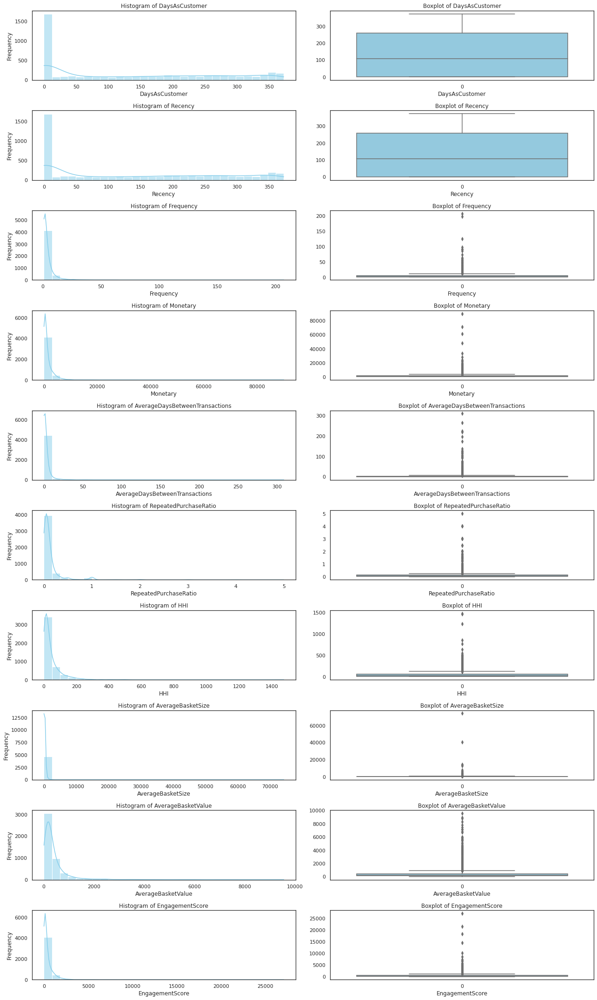

In [0]:
# Convert PySpark DataFrame to Pandas DataFrame
df_pandas = df_customer_features.toPandas()

# List of features to visualize
features = [
    'DaysAsCustomer', 'Recency', 'Frequency', 'Monetary', 
    'AverageDaysBetweenTransactions', 'RepeatedPurchaseRatio', 
    'HHI', 'AverageBasketSize', 'AverageBasketValue', 'EngagementScore'
]

# Create a figure with 10 rows and 2 columns for the plots
fig, axes = plt.subplots(nrows=10, ncols=2, figsize=(18, 30))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Generate histograms and boxplots for each feature
for i, feature in enumerate(features):
    # Histogram on the first column
    sns.histplot(df_pandas[feature], kde=True, ax=axes[2*i], color='skyblue', bins=30)
    axes[2*i].set_title(f'Histogram of {feature}')
    axes[2*i].set_xlabel(feature)
    axes[2*i].set_ylabel('Frequency')

    # Boxplot on the second column
    sns.boxplot(data=df_pandas[feature], ax=axes[2*i+1], color='skyblue')
    axes[2*i+1].set_title(f'Boxplot of {feature}')
    axes[2*i+1].set_xlabel(feature)

plt.tight_layout()  # Adjust the layout to prevent overlap
plt.show()

Based on the histograms and boxplots, we observe that all features exhibit right-skewed distributions. Additionally, all features except for `DaysAsCustomer` and `Recency` contain a significant number of outliers. These issues need to be addressed prior to clustering, as most clustering algorithms, such as K-means, rely on distance-based metrics like Euclidean distance.

Right-skewed distributions and extreme outliers can disproportionately influence distance calculations, causing clusters to be biased toward data points with larger values. This can lead to poorly separated or distorted clusters, as the algorithm may focus more on high-magnitude outliers than on the underlying structure of the majority of data. Therefore, proper scaling and outlier mitigation are critical steps before applying clustering techniques.

__`Step 30`__ Checking for the redundancy of features through the Spearman correlation matrix.

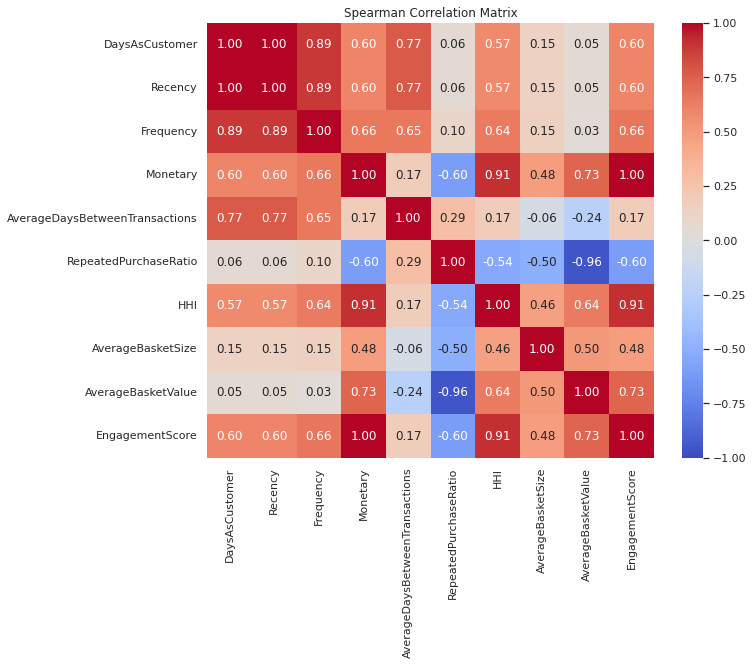

In [0]:
# List of numerical columns for correlation computation
numerical_cols = ["DaysAsCustomer", "Recency", "Frequency", "Monetary", "AverageDaysBetweenTransactions",    
                  "RepeatedPurchaseRatio", "HHI", "AverageBasketSize", "AverageBasketValue", "EngagementScore"
]

# Select the columns from the DataFrame
df_numerical = df_customer_features.select(numerical_cols)

# Collect the data to a Pandas DataFrame for easier handling
pandas_df = df_numerical.toPandas()

# Compute the Spearman correlation matrix using pandas
correlation_matrix_df = pandas_df.corr(method='spearman')

# Plot the correlation matrix using seaborn heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix_df, annot=True, cmap="coolwarm", fmt=".2f", vmin=-1, vmax=1)
plt.title("Spearman Correlation Matrix")
plt.show()

Based on the correlation matrix analysis, we have decided to exclude the following features from the set used for clustering customers:

- `DaysAsCustomer` and `Recency`: These features were removed due to their strong correlation with each other and with `Frequency`, indicating redundancy.

- `HHI` and `EngagementScore`: These were excluded because of their high correlation with each other and with `Monetary`, which may introduce multicollinearity and dilute the distinctiveness of other features.

- `AverageBasketValue`: This feature was removed due to its high correlation with `RepeatedPurchaseRatio`. We chose to retain `RepeatedPurchaseRatio` instead, as it offers more actionable insights for generating customer recommendations.

__`Step 30.1`__ Plotting the correlation matrix of the features deemed as not redundant for clustering, to ensure that there is not any remaining redundancies.

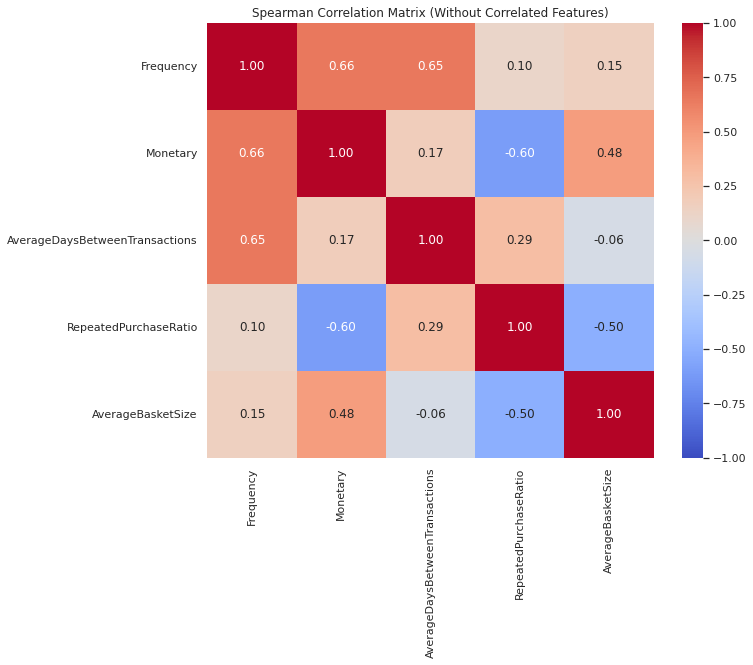

In [0]:
# List of numerical columns for correlation computation
numerical_cols = ["Frequency", "Monetary", "AverageDaysBetweenTransactions", "RepeatedPurchaseRatio",   
                  "AverageBasketSize"]

# Select the columns from the DataFrame
df_numerical = df_customer_features.select(numerical_cols)

# Collect the data to a Pandas DataFrame for easier handling
pandas_df = df_numerical.toPandas()

# Compute the Spearman correlation matrix using pandas
correlation_matrix_df = pandas_df.corr(method='spearman')

# Plot the correlation matrix using seaborn heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix_df, annot=True, cmap="coolwarm", fmt=".2f", vmin=-1, vmax=1)
plt.title("Spearman Correlation Matrix (Without Correlated Features)")
plt.show()

From this new correlation matrix there are no redundant features.

__`Step 31`__ Creating a feature transformation pipeline that performs a vector assemble, then performs scaling through (RobustScaler) and finishes with normalizing the features for clustering.

In [0]:
# Creating a list with the features to use
features_to_scale = ["Frequency", "Monetary", "AverageDaysBetweenTransactions", "RepeatedPurchaseRatio",   
                     "AverageBasketSize"]

# Existing pipeline steps
assembler = VectorAssembler(inputCols=features_to_scale, outputCol="features_vector")
scaler = RobustScaler(inputCol="features_vector", outputCol="scaled_features")

# Add normalization (L2 by default, can set p=1 for L1)
normalizer = Normalizer(inputCol="scaled_features", outputCol="normalized_features", p=2)

# Full pipeline
pipeline = Pipeline(stages=[assembler, scaler, normalizer])

# Fit and transform
pipeline_model = pipeline.fit(df_customer_features)
normalized_df = pipeline_model.transform(df_customer_features)

# View result
display(normalized_df.select("CustomerNo", "normalized_features"))

CustomerNo,normalized_features
14570,"Map(vectorType -> dense, length -> 5, values -> List(0.49228667703876317, 0.2625987913057362, 0.0, 0.795614831577799, 0.23599309775569577))"
16339,"Map(vectorType -> dense, length -> 5, values -> List(0.3448391389876907, 0.2744156098609385, 0.0, 0.8851485920539653, 0.14931179213900012))"
17420,"Map(vectorType -> dense, length -> 5, values -> List(0.1724612411723362, 0.05452740039661088, 0.9402572748129181, 0.2687707654633811, 0.10470155535090284))"
13285,"Map(vectorType -> dense, length -> 5, values -> List(0.3078507589987097, 0.45775496251079684, 0.1622372139557495, 0.0855636157031735, 0.8136622509102494))"
13832,"Map(vectorType -> dense, length -> 5, values -> List(0.1328961187480609, 0.37984443346499513, 0.22963967504505797, 0.04460848741193652, 0.8850607496004879))"
14450,"Map(vectorType -> dense, length -> 5, values -> List(0.39240960925664037, 0.19309412451284277, 0.6895308998622713, 0.5351040126226915, 0.2166568518461634))"
15727,"Map(vectorType -> dense, length -> 5, values -> List(0.38853431101664604, 0.7637079461970652, 0.0931914625072255, 0.07959729803157922, 0.5007702901931357))"
15957,"Map(vectorType -> dense, length -> 5, values -> List(0.2511404446086411, 0.23223638813163333, 0.8666753535042311, 0.2236501176477694, 0.28609298071396744))"
17679,"Map(vectorType -> dense, length -> 5, values -> List(0.23222302859585217, 0.1576087292736513, 0.19402744118107856, 0.34942650070849224, 0.8726318961153414))"
16386,"Map(vectorType -> dense, length -> 5, values -> List(0.3360947280189932, 0.8998399572859537, 0.1065418419022752, 0.05751353634549616, 0.25033859896260063))"


__`Step 31.1`__ Checking if the features have less outliers after the normalization transformation.

In [0]:
# Convert vector column to array, then split into separate columns
normalized_df_array = normalized_df.withColumn("normalized_array", vector_to_array("normalized_features"))

# Rebuild a DataFrame with each feature as a column
for i, col_name in enumerate(features_to_scale):
    normalized_df_array = normalized_df_array.withColumn(col_name + "_scaled", F.col("normalized_array")[i])

# Select only the scaled columns and convert to Pandas
pandas_scaled_df = normalized_df_array.select([col + "_scaled" for col in features_to_scale]).toPandas()

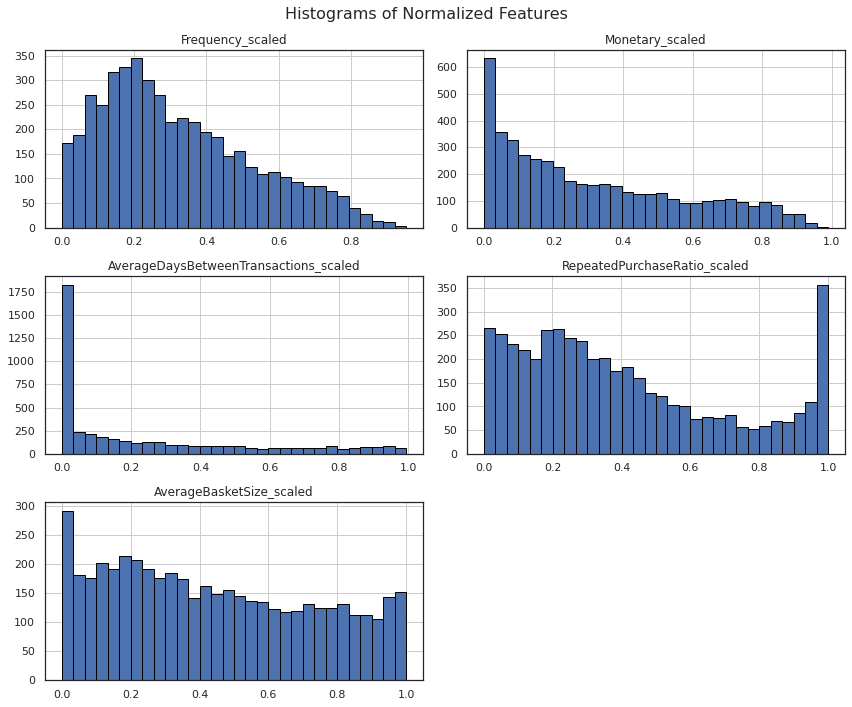

In [0]:
# Plot histogram for each feature
pandas_scaled_df.hist(bins=30, figsize=(12, 10), edgecolor='black')
plt.suptitle("Histograms of Normalized Features", fontsize=16)
plt.tight_layout()
plt.show()

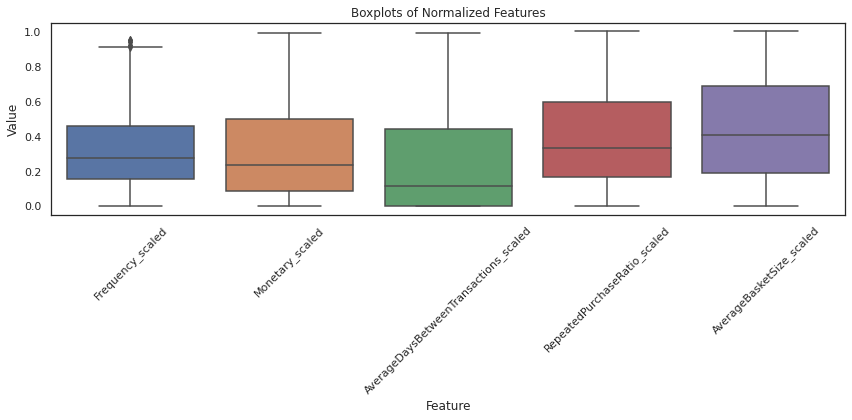

In [0]:
# Melt the dataframe for seaborn boxplot
melted_df = pd.melt(pandas_scaled_df, var_name='Feature', value_name='Value')

plt.figure(figsize=(12, 6))
sns.boxplot(data=melted_df, x='Feature', y='Value')
plt.xticks(rotation=45)
plt.title("Boxplots of Normalized Features")
plt.tight_layout()
plt.show()

The features contain fewer outliers, which is beneficial for clustering because outliers can distort distance calculations and lead to poorly defined or misleading clusters. By reducing the outliers, our team ensures that clusters are more compact, representative, and meaningful.

# 4. Modelling 

## 4.1. Customer Segmentation

__`Step 32`__ Comparing the silhouette scores of solutions with 2 up to 10 clusters to check what is the best one.

In [0]:
# Evaluator for clustering (uses Silhouette with squared Euclidean distance)
evaluator = ClusteringEvaluator(featuresCol="normalized_features", metricName="silhouette", distanceMeasure="squaredEuclidean")

# Store results
silhouette_scores = []
models = []

# Loop over K values from 2 to 10 (1 cluster has no meaningful Silhouette score)
for k in range(2, 11):
    kmeans = KMeans(featuresCol="normalized_features", k=k, seed=42)
    model = kmeans.fit(normalized_df)
    predictions = model.transform(normalized_df)
    
    # Evaluate the clustering
    score = evaluator.evaluate(predictions)
    silhouette_scores.append((k, score))
    models.append((k, model))

# Show the scores
for k, score in silhouette_scores:
    print(f"K={k} => Silhouette Score: {score:.4f}")

K=2 => Silhouette Score: 0.4784
K=3 => Silhouette Score: 0.4668
K=4 => Silhouette Score: 0.5860
K=5 => Silhouette Score: 0.5738
K=6 => Silhouette Score: 0.5419
K=7 => Silhouette Score: 0.5284
K=8 => Silhouette Score: 0.5251
K=9 => Silhouette Score: 0.5054
K=10 => Silhouette Score: 0.4907


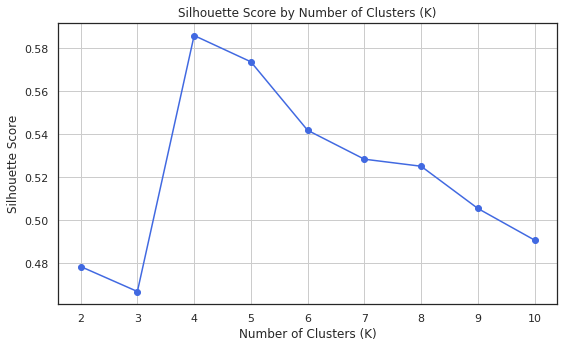

In [0]:
# Unpack k values and corresponding scores
k_values, scores = zip(*silhouette_scores)

# Plot
plt.figure(figsize=(8, 5))
plt.plot(k_values, scores, marker='o', linestyle='-', color='royalblue')
plt.title("Silhouette Score by Number of Clusters (K)")
plt.xlabel("Number of Clusters (K)")
plt.ylabel("Silhouette Score")
plt.xticks(k_values)
plt.grid(True)
plt.tight_layout()
plt.show()


Based on the plot of the silhouette values the most suitable number of clusters to go with would be 4.

__`Step 32.1.`__ Checking what is the best number of clusters making use of the elbow method.

In [0]:
# Store WSSSE values for each k
wssse_scores = []

for k in range(2, 11):
    kmeans = KMeans(featuresCol="normalized_features", k=k, seed=42)
    model = kmeans.fit(normalized_df)
    
    # Compute WSSSE
    wssse = model.summary.trainingCost
    wssse_scores.append((k, wssse))

# Display the results
for k, wssse in wssse_scores:
    print(f"K={k} => WSSSE: {wssse:.2f}")

K=2 => WSSSE: 1186.27
K=3 => WSSSE: 904.22
K=4 => WSSSE: 562.36
K=5 => WSSSE: 456.69
K=6 => WSSSE: 403.62
K=7 => WSSSE: 350.53
K=8 => WSSSE: 315.73
K=9 => WSSSE: 294.53
K=10 => WSSSE: 269.13


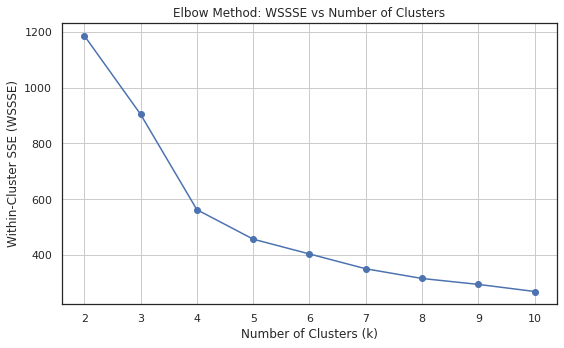

In [0]:
# Convert results to Pandas DataFrame
wssse_df = pd.DataFrame(wssse_scores, columns=["k", "WSSSE"])

# Plot
plt.figure(figsize=(8, 5))
plt.plot(wssse_df["k"], wssse_df["WSSSE"], marker='o', linestyle='-')
plt.title("Elbow Method: WSSSE vs Number of Clusters")
plt.xlabel("Number of Clusters (k)")
plt.ylabel("Within-Cluster SSE (WSSSE)")
plt.xticks(wssse_df["k"])
plt.grid(True)
plt.tight_layout()
plt.show()

Based on the elbow method the number of clusters to go with should be 4.

Summarizing:

- Silhouette: 4 clusters
- Elbow: 4 clusters

**Final Decision:** 4 clusters

Hierarchical clustering is not natively supported in Spark or Databricks, which made it unfeasible to implement within our distributed environment. As a result, we were unable to follow our initial plan of using a hybrid approach—applying hierarchical clustering to determine the optimal number of clusters, followed by K-Means for scalable clustering.

For that reason we decided to empower K-Means solely.

__`Step 33`__ Performing K-Means clustering with the ideal number of clusters (K=4).

In [0]:
# Initialize KMeans with normalized features
kmeans = KMeans(featuresCol="normalized_features", predictionCol="cluster", k=4, seed=42)

# Fit the model
kmeans_model = kmeans.fit(normalized_df)

# Apply clustering to your dataset
clustered_df = kmeans_model.transform(normalized_df)

__`Step 34`__ Plotting the centroids of the clusters.

In [0]:
# Get cluster centers as a list of DenseVectors
centroids = kmeans_model.clusterCenters()

# Create a DataFrame for better visualization
centroids_df = pd.DataFrame(centroids, columns=features_to_scale)

# Display the centroids in a neat table format
print("Centroids of Clusters:")
centroids_df

Centroids of Clusters:


,Frequency,Monetary,AverageDaysBetweenTransactions,RepeatedPurchaseRatio,AverageBasketSize
0,0.188515,0.073292,0.049299,0.899742,0.236666
1,0.519735,0.609456,0.171517,0.214500,0.374520
2,0.214625,0.282053,0.082715,0.250851,0.833720
3,0.295072,0.148575,0.730390,0.417813,0.244891


After analyzing customer purchasing behavior, we grouped customers into distinct segments, each with its own unique buying patterns. Here's a breakdown of the clusters:

| Cluster | Name                         | Description |
|---------|------------------------------|-------------|
| **0**   | **New routine clients**     | These clients don't tend to buy a lot of products per transaction (low values on `AverageBasketSize` and `Monetary`) from the company. Although they buy very frequently and very similar products (high values on `AverageDaysBetweenTransactions` and `RepeatedPurchaseRatio`), showing some routine purchase behavior. Lastly, despite this frequent activity, these clients have low `Frequency` values overall. This pattern suggests that they are new customers — they haven't been with the company for long, but are already forming consistent purchasing habits.|
| **1**   | **Premium novely seekers:**   | Clients in this cluster buy occasionally, tend to buy different products, and even though they only have a moderate basket size, they buy the most valuable products as can be seen in by the high `Monetary` value. This behavior shows a tendency to try out new expensive products from the store which is a common occurence as they have the highest `Frequency` of any cluster. |
| **2**   | **Growing Shoppers**         | These customers show moderate spending and frequency, with a relatively high Basket Size. They're still developing loyalty, but have good potential with proper engagement. |
| **3**   | **Infrequent Big-Ticket Buyers** | This group buys rarely (highest *AvgDaysBetweenTransactions*) and doesn’t repeat often. They're more difficult to activate but may respond to event-driven or seasonal campaigns. |


__`Step 35`__ Plotting the cluster sizes of the previously created clusters.

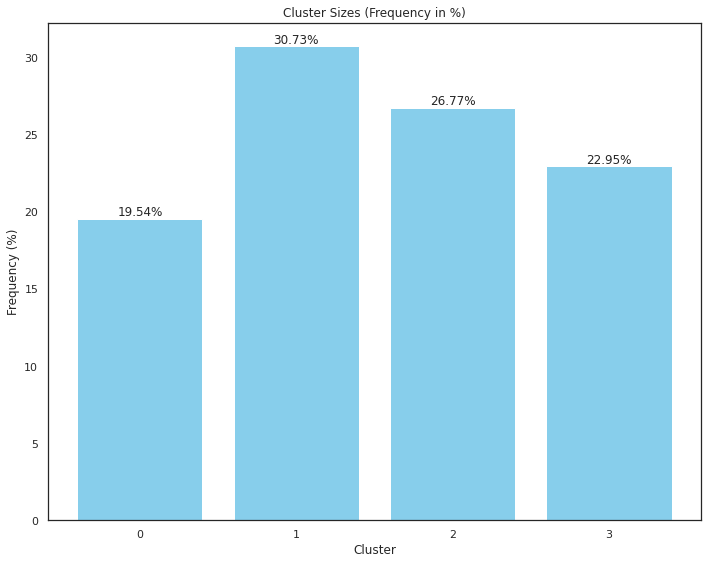

In [0]:
# Group by the cluster and count the number of samples per cluster
cluster_sizes = clustered_df.groupBy("cluster").count().toPandas()

# Rename columns for clarity
cluster_sizes.columns = ['Cluster', 'Size']

# Calculate frequency as percentage of total
total_size = cluster_sizes['Size'].sum()
cluster_sizes['Frequency (%)'] = (cluster_sizes['Size'] / total_size) * 100

# Plotting the cluster sizes as percentages
plt.figure(figsize=(10, 8))
bars = plt.bar(cluster_sizes['Cluster'], cluster_sizes['Frequency (%)'], color='skyblue')

# Display the values on top of the bars
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval, f'{yval:.2f}%', ha='center', va='bottom')

plt.xlabel('Cluster')
plt.ylabel('Frequency (%)')
plt.title('Cluster Sizes (Frequency in %)')
plt.xticks(cluster_sizes['Cluster'])
plt.tight_layout()
plt.show()

From the plot, we can observe that the clusters are well-balanced, which is a positive outcome. Additionally, the good separability between the clusters, as reflected in the centroids, further supports the robustness and effectiveness of the clustering process.

__`Step 36`__ Making a 2D representation of our clusters, making use of T-SNE.

/databricks/spark/python/pyspark/sql/pandas/conversion.py:122: UserWarning:

toPandas attempted Arrow optimization because 'spark.sql.execution.arrow.pyspark.enabled' is set to true; however, failed by the reason below:
  Unable to convert the field normalized_features. If this column is not necessary, you may consider dropping it or converting to primitive type before the conversion.
Direct cause: Unsupported type in conversion to Arrow: VectorUDT()
Attempting non-optimization as 'spark.sql.execution.arrow.pyspark.fallback.enabled' is set to true.

/databricks/python/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/databricks/python/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



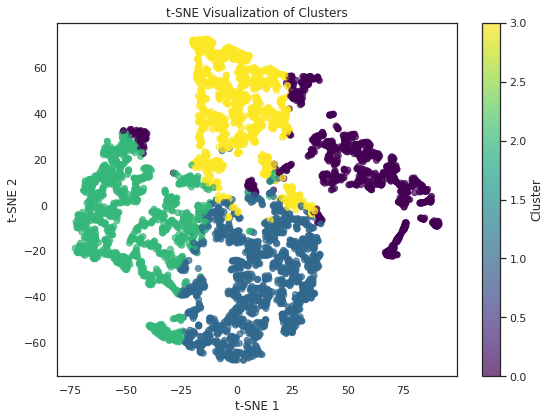

In [0]:
# Convert the normalized features column from Spark DataFrame to Pandas
normalized_features_pandas = clustered_df.select("normalized_features", "cluster").toPandas()

# Extract the normalized features for t-SNE
X = pd.DataFrame(normalized_features_pandas['normalized_features'].tolist())

# Apply t-SNE to reduce dimensions to 2D (for visualization)
tsne = TSNE(n_components=2, random_state=42)
X_tsne = tsne.fit_transform(X)

# Add t-SNE results to the original DataFrame
normalized_features_pandas['t-SNE 1'] = X_tsne[:, 0]
normalized_features_pandas['t-SNE 2'] = X_tsne[:, 1]

# Plot the t-SNE results
plt.figure(figsize=(8, 6))
plt.scatter(normalized_features_pandas['t-SNE 1'], normalized_features_pandas['t-SNE 2'], c=normalized_features_pandas['cluster'], cmap='viridis', alpha=0.7)
plt.colorbar(label='Cluster')
plt.title('t-SNE Visualization of Clusters')
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')
plt.tight_layout()
plt.show()

The plot shows that our clusters are well-separated, with only a small degree of overlap. While some observations from one cluster are slightly closer to another cluster than to their own, the level of error is minimal and does not significantly affect the overall clustering quality.

__`Step 37`__ Imputting the customer segment in the transactional data.

In [0]:
# Join df_cleaned with clustered_df based on 'CustomerNo'
df_cleaned = df_cleaned.join(clustered_df.select("CustomerNo", "cluster"), on="CustomerNo", how="left")

# Display the DataFrame in Databricks
display(df_cleaned)

CustomerNo,TransactionNo,Date,ProductNo,ProductName,Price,Quantity,Country,cluster
13047,536367,2018-12-01,21755,Love Building Block Word,16.35,3,United Kingdom,1
12583,536370,2018-12-01,21724,Panda And Bunnies Sticker Sheet,11.12,12,France,1
12583,536370,2018-12-01,22631,Circus Parade Lunch Box,12.25,24,France,1
12583,536370,2018-12-01,22661,Charlotte Bag Dolly Girl Design,11.12,20,France,1
17850,536373,2018-12-01,21071,Vintage Billboard Drink Me Mug,11.34,6,United Kingdom,0
17850,536373,2018-12-01,82482,Wooden Picture Frame White Finish,12.4,6,United Kingdom,0
17850,536375,2018-12-01,20679,Edwardian Parasol Red,15.32,6,United Kingdom,0
17850,536375,2018-12-01,82486,3 Drawer Antique White Wood Cabinet,17.37,4,United Kingdom,0
17850,536375,2018-12-01,84029G,Knitted Union Flag Hot Water Bottle,13.72,6,United Kingdom,0
17850,536375,2018-12-01,84406B,Cream Cupid Hearts Coat Hanger,13.07,8,United Kingdom,0


## 4.2. Recommender System

__`Step 38`__ Creating a function that allows us to make a recommender system.

In [0]:
def generate_recommendations(df_cleaned: DataFrame, target_customer_id: int, cart_items: list = None) -> None:
    import pandas as pd

    TOP_N = 5  # fixed number of recommendations

    df_pd = df_cleaned.select(
        "TransactionNo", "Date", "ProductNo", "ProductName", "Price",
        "Quantity", "CustomerNo", "Country", "cluster"
    ).toPandas()

    if cart_items is None:
        cart_items = []

    product_name_map = df_pd.dropna(subset=["ProductNo", "ProductName"]) \
                            .drop_duplicates(subset=["ProductNo"]) \
                            .set_index("ProductNo")["ProductName"].to_dict()

    customer_group = df_pd.groupby("CustomerNo")
    customer_baskets = customer_group['ProductNo'].apply(set).to_dict()
    customer_transactions = customer_group['TransactionNo'].nunique().to_dict()

    customer_cluster_series = df_pd[df_pd['CustomerNo'] == target_customer_id]['cluster']
    if customer_cluster_series.empty:
        top_products = df_pd['ProductNo'].value_counts().head(TOP_N).index.tolist()
        print("🆕 Products that you might like:")
        print([product_name_map.get(p, p) for p in top_products])
        return

    customer_cluster = customer_cluster_series.iloc[0]
    cluster_df = df_pd[df_pd['cluster'] == customer_cluster]
    cluster_customers = cluster_df['CustomerNo'].unique().tolist()
    cluster_customers = [c for c in cluster_customers if c != target_customer_id]

    if cart_items:
        # --- Recommendations based on cart ---
        related_tx = df_pd[df_pd['ProductNo'].isin(cart_items)]['TransactionNo'].unique()
        co_products_df = df_pd[
            df_pd['TransactionNo'].isin(related_tx) & ~df_pd['ProductNo'].isin(cart_items)
        ]
        co_occur_products = (
            co_products_df['ProductNo'].value_counts()
            .head(TOP_N * 2)  # buffer in case of duplicates
            .index.tolist()
        )[:TOP_N]

        def jaccard(set1, set2):
            if not set1 or not set2:
                return 0
            return len(set1 & set2) / len(set1 | set2)

        customer_products = customer_baskets.get(target_customer_id, set())
        similarities = []
        for other_customer in cluster_customers:
            other_products = customer_baskets.get(other_customer, set())
            sim = jaccard(set(customer_products) | set(cart_items), other_products)
            similarities.append((other_customer, sim))

        similarities = sorted(similarities, key=lambda x: -x[1])
        seen_products = set(cart_items) | set(co_occur_products) | customer_products
        cluster_recommendations = []

        for cust, sim in similarities:
            if sim == 0:
                continue
            for prod in customer_baskets.get(cust, set()):
                if prod not in seen_products:
                    cluster_recommendations.append(prod)
                    seen_products.add(prod)
                    if len(cluster_recommendations) >= TOP_N:
                        break
            if len(cluster_recommendations) >= TOP_N:
                break

        # Fill if not enough
        if len(cluster_recommendations) < TOP_N:
            top_products = df_pd['ProductNo'].value_counts().index.tolist()
            for prod in top_products:
                if prod not in seen_products:
                    cluster_recommendations.append(prod)
                if len(cluster_recommendations) >= TOP_N:
                    break

        # Output
        print(f"\n🧑 Recommendations for Customer {target_customer_id}")
        print("\n📦 Based on your cart:")
        print([product_name_map.get(p, p) for p in co_occur_products])
        print("\n👥 Other people similar to you also like:")
        print([product_name_map.get(p, p) for p in cluster_recommendations])
        return

    # --- Recommendations when CART is empty ---
    tx_count = customer_transactions.get(target_customer_id, 0)

    if tx_count == 0:
        top_products = df_pd['ProductNo'].value_counts().head(TOP_N).index.tolist()
        print("🆕 Products that you might like:")
        print([product_name_map.get(p, p) for p in top_products])
        return

    customer_products = customer_baskets.get(target_customer_id, set())

    if tx_count == 1:
        last_tx = (
            df_pd[df_pd['CustomerNo'] == target_customer_id]
            .sort_values('Date')['TransactionNo']
            .iloc[-1]
        )
        last_products = set(df_pd[df_pd['TransactionNo'] == last_tx]['ProductNo'].tolist())
        based_on_you = list(last_products)[:TOP_N]
    else:
        recent_products = df_pd[
            df_pd['CustomerNo'] == target_customer_id
        ].sort_values('Date')['ProductNo'].tolist()

        based_on_you = []
        seen = set()
        for prod in reversed(recent_products):
            if prod not in seen:
                based_on_you.append(prod)
                seen.add(prod)
            if len(based_on_you) >= TOP_N:
                break

    def jaccard(set1, set2):
        if not set1 or not set2:
            return 0
        return len(set1 & set2) / len(set1 | set2)

    similarities = []
    for other_customer in cluster_customers:
        other_products = customer_baskets.get(other_customer, set())
        sim = jaccard(customer_products, other_products)
        similarities.append((other_customer, sim))

    similarities = sorted(similarities, key=lambda x: -x[1])
    seen_products = set(based_on_you) | customer_products
    cluster_recommendations = []

    for cust, sim in similarities:
        if sim == 0:
            continue
        for prod in customer_baskets.get(cust, set()):
            if prod not in seen_products:
                cluster_recommendations.append(prod)
                seen_products.add(prod)
                if len(cluster_recommendations) >= TOP_N:
                    break
        if len(cluster_recommendations) >= TOP_N:
            break

    if len(cluster_recommendations) < TOP_N:
        top_products = df_pd['ProductNo'].value_counts().index.tolist()
        for prod in top_products:
            if prod not in seen_products:
                cluster_recommendations.append(prod)
            if len(cluster_recommendations) >= TOP_N:
                break

    # Output
    print(f"\n🧑 Recommendations for Customer {target_customer_id}")
    print("\n📦 Based on your purchases:")
    print([product_name_map.get(p, p) for p in based_on_you])
    print("\n👥 Other people similar to you also like:")
    print([product_name_map.get(p, p) for p in cluster_recommendations])

__`Step 38.1`__ Applying to customer whose ID is `17754`.

In [0]:
generate_recommendations(df_cleaned, target_customer_id=17754)


🧑 Recommendations for Customer 17754

📦 Based on your purchases:
['Charlie+Lola Pink Hot Water Bottle', 'Charlie Lola Blue Hot Water Bottle', 'Ceramic Cherry Cake Money Bank', 'Ceramic Strawberry Cake Money Bank', 'Small Yellow Babushka Notebook']

👥 Other people similar to you also like:
['Jigsaw Toadstools 3 Piece', 'Strawberry Fairy Cake Teapot', 'French Style Storage Jar Jam', 'Green Christmas Tree Card Holder', 'Jigsaw Tree With Watering Can']


__`Step 38.2`__ Adding an item to the cart of the customer to see the changes.

In [0]:
generate_recommendations(df_cleaned, target_customer_id=17754, cart_items=['85123A'])


🧑 Recommendations for Customer 17754

📦 Based on your cart:
['Red Hanging Heart T-Light Holder', 'Jumbo Bag Red Retrospot', 'Natural Slate Heart Chalkboard', 'Wooden Picture Frame White Finish', 'Heart Of Wicker Small']

👥 Other people similar to you also like:
['Jigsaw Toadstools 3 Piece', 'Strawberry Fairy Cake Teapot', 'French Style Storage Jar Jam', 'Green Christmas Tree Card Holder', 'Jigsaw Tree With Watering Can']


__`Step 38.3`__ Checking for client whose ID is `13471`.

In [0]:
generate_recommendations(df_cleaned, target_customer_id=13471)


🧑 Recommendations for Customer 13471

📦 Based on your purchases:
['Large Cake Stand Hanging Strawbery', 'Jam Making Set Printed', 'Jam Making Set With Jars', 'Mini Cake Stand Hanging Strawbery', 'Set Of 3 Butterfly Cookie Cutters']

👥 Other people similar to you also like:
['Strawberry Fairy Cake Teapot', 'Airline Bag Vintage Tokyo 78', 'Memo Board Retrospot Design', 'Childrens Dolly Girl Mug', 'Buffalo Bill Treasure Book Box']


__`Step 38.4`__ Checking if the product as products in the cart.

In [0]:
generate_recommendations(df_cleaned, target_customer_id=13471, cart_items=['22649', '22371'])


🧑 Recommendations for Customer 13471

📦 Based on your cart:
['Jumbo Bag Red Retrospot', 'Strawberry Ceramic Trinket Pot', 'Cream Hanging Heart T-Light Holder', 'Popcorn Holder', 'Suki Shoulder Bag']

👥 Other people similar to you also like:
['Memo Board Retrospot Design', 'Childrens Dolly Girl Mug', 'Buffalo Bill Treasure Book Box', 'Travel Card Wallet Transport', 'Set Of 3 Black Flying Ducks']


**🧠 How Recommendations are Generated**

The function in step 38 recommends products to customers based on two different scenarios: whether or not they currently have items in their shopping cart.

---

**🔹 Scenario 1: Customer Has Items in Their Cart**

**Step 1: Based on Your Cart**
- Find all transactions that included the items currently in the cart.
- Identify other products that frequently appeared in those same transactions.
- Recommend the most common of those as "Based on your cart" suggestions.

**Step 2: Other People Similar to You Also Like**
- Identify the customer’s cluster (group of similar customers).
- For each customer in the same cluster:
  - Calculate **similarity** based on their past purchases + current cart.
  - Recommend products those similar customers bought, excluding ones already in the current customer’s cart or purchase history.

---

**🔹 Scenario 2: Customer Has an Empty Cart**

**Step 1: Based on Your Purchases**
- If the customer is new:
  - Recommend popular top-selling products.
- If the customer has a purchase history:
  - Recommend products they’ve recently bought or buy often.

**Step 2: Other People Similar to You Also Like**
- Identify other customers in the same cluster.
- Compare the customer’s purchase history to others using **Jaccard similarity**.
- Recommend products from the most similar customers that the target customer hasn’t purchased yet.

---

**⚙️ Smart Features**

- Recommendations avoid suggesting items already in the cart.
- If no good matches are found, fallback to best-selling products.
- The number of products shown is based on average basket size (dynamic).

---

**💡 Business Value**

- Increases **cross-sell** by suggesting frequently co-purchased items.
- Enhances **personalization** with customer-specific and group-based insights.
- Works for both **new and returning** customers by adapting its logic.


## 4.3. *Did you forget?* Recommender

__`Step 39`__ Creating a function to make the recommendation system of the *Did you forget?* case in the check-out of a purchase.

In [0]:
def recommend_did_you_forget(client_id, df_cleaned_spark, top_n=5, similarity_metric='jaccard'):
    """
    Recommend products based on the last transaction of a customer.
    
    Parameters:
    - client_id (int): CustomerNo of the target client.
    - df_cleaned_spark (Spark DataFrame): Cleaned transactional data.
    - top_n (int): Number of product recommendations.
    - similarity_metric (str): Similarity metric (e.g., 'jaccard').

    Returns:
    - Pandas DataFrame of recommended products and similarity scores.
    """

    # Step 1: Get the customer's last transaction
    last_tx_row = df_cleaned_spark.filter(F.col("CustomerNo") == client_id) \
        .select("TransactionNo", "Date") \
        .orderBy(F.col("Date").desc()) \
        .limit(1) \
        .collect()

    if not last_tx_row:
        print("⚠️ No transactions found for this customer.")
        return pd.DataFrame()

    last_tx_id = last_tx_row[0]["TransactionNo"]

    # Step 2: Get the products in that transaction (current basket)
    client_products = df_cleaned_spark.filter(F.col("TransactionNo") == last_tx_id) \
        .select("ProductName").distinct().rdd.flatMap(lambda x: x).collect()

    if not client_products:
        print("⚠️ No products found in the last transaction.")
        return pd.DataFrame()

    # Step 3: Get client's cluster
    cluster_row = df_cleaned_spark.filter(F.col("CustomerNo") == client_id) \
        .select("cluster") \
        .limit(1) \
        .collect()

    if not cluster_row:
        print("⚠️ Cluster not found for this client.")
        return pd.DataFrame()

    cluster_id = cluster_row[0]["cluster"]

    # Step 4: Get all customers in the same cluster
    cluster_customers = df_cleaned_spark.filter(F.col("cluster") == cluster_id) \
        .select("CustomerNo").distinct().rdd.flatMap(lambda x: x).collect()

    # Step 5: Get transactions of those customers (excluding current basket items)
    relevant_df = df_cleaned_spark.filter(F.col("CustomerNo").isin(cluster_customers)) \
        .select("CustomerNo", "ProductName") \
        .dropna().distinct().toPandas()

    if relevant_df.empty:
        print("⚠️ No relevant transactions in this cluster.")
        return pd.DataFrame()

    # Step 6: Create a customer-product binary matrix
    pivot = pd.pivot_table(relevant_df, index='CustomerNo', columns='ProductName',
                           aggfunc=lambda x: 1, fill_value=0)

    if pivot.shape[1] < 2:
        print("⚠️ Not enough data to compute similarity.")
        return pd.DataFrame()

    # Step 7: Compute product similarity matrix
    product_matrix = pivot.T.to_numpy()
    dist_matrix = pairwise_distances(product_matrix, metric=similarity_metric)
    similarity_df = pd.DataFrame(1 - dist_matrix, index=pivot.columns, columns=pivot.columns)

    # Step 8: Recommend products not in the basket but similar to them
    basket_items = client_products
    candidates = [p for p in similarity_df.columns if p not in basket_items]
    temp_df = similarity_df.loc[basket_items, candidates]

    recommendations = []
    for product in candidates:
        best_match = temp_df[product].idxmax()
        score = temp_df.loc[best_match, product]
        recommendations.append({
            'RecommendedProduct': product,
            'MostSimilarTo': best_match,
            'SimilarityScore': round(score, 4)
        })

    result_df = pd.DataFrame(recommendations).sort_values(by='SimilarityScore', ascending=False)
    return result_df.head(top_n)

__`Step 39.1`__ Checking what would be the recommended products for the customer whose ID is `17754`.

In [0]:
recommend_did_you_forget(client_id=17754, df_cleaned_spark=df_cleaned)

/databricks/python/lib/python3.9/site-packages/sklearn/metrics/pairwise.py:1875: DataConversionWarning:

Data was converted to boolean for metric jaccard



,RecommendedProduct,MostSimilarTo,SimilarityScore
1744,Milk Pan Red Retrospot,Frying Pan Red Retrospot,0.4286
2960,Suki Shoulder Bag,Charlie+Lola Pink Hot Water Bottle,0.3673
653,Chilli Lights,Ceramic Heart Fairy Cake Money Bank,0.3487
121,6 Ribbons Empire,6 Ribbons Elegant Christmas,0.3444
2489,Round Snack Boxes Set Of 4 Skulls,Ceramic Heart Fairy Cake Money Bank,0.3403


This function generates personalized product recommendations for a given client based on products purchased by other clients within the same cluster. It uses a similarity-based approach, comparing product purchase patterns to find the most relevant items.

#### **How it works:**

1. **Identify Client's Basket:**
   - Retrieves the unique list of products purchased by the specified client.

2. **Determine Cluster:**
   - Finds which customer segment (cluster) the client belongs to.

3. **Select Relevant Customers:**
   - Filters all other customers in the same cluster.

4. **Build Customer-Product Matrix:**
   - Constructs a binary matrix where rows are customers and columns are products (1 if purchased).

5. **Compute Product Similarities:**
   - Uses a similarity metric (e.g., Jaccard) to compare product co-purchase patterns across customers.

6. **Generate Recommendations:**
   - Identifies products not yet purchased by the client that are most similar to items in their basket.
   - Scores are rounded to 4 decimal places for clarity.

# 5. Streaming

__`Step 40`__ Create a function to simulate a cart stream.

In [0]:
def simulate_cart_stream(df_cleaned_spark, customer_id: int, stream_path="/tmp/stream_cart_events", top_n=5):

    # Step 1: Get last transaction of customer
    last_tx_row = df_cleaned_spark.filter(F.col("CustomerNo") == customer_id) \
        .orderBy(F.col("Date").desc()) \
        .select("TransactionNo") \
        .limit(1) \
        .collect()

    if not last_tx_row:
        print("❌ No previous transaction found.")
        return

    last_tx_id = last_tx_row[0]["TransactionNo"]

    # Step 2: Get products in the last transaction
    cart_df = df_cleaned_spark.filter(F.col("TransactionNo") == last_tx_id) \
        .select("ProductNo") \
        .distinct() \
        .withColumn("CustomerNo", lit(customer_id)) \
        .withColumn("event_time", current_timestamp())

    cart_items = cart_df.collect()

    if not cart_items:
        print("❌ No items found in last transaction.")
        return

    # Initialize cart state
    cart_items_so_far = []

    # Step 3: Simulate adding products one-by-one
    for i, row in enumerate(cart_items):
        single_df = spark.createDataFrame([row.asDict()])
        single_df.write.mode("append").format("delta").save(stream_path)
        
        # Update cart state
        product_id = row["ProductNo"]
        cart_items_so_far.append(product_id)

        print(f"🛒 Added product {i+1}/{len(cart_items)} to stream.")

        # Call recommendation engine using updated cart
        print(f"\n📢 Recommending after {i+1} item(s) in the cart...")
        generate_recommendations(df_cleaned_spark, target_customer_id=customer_id, cart_items=cart_items_so_far)

        time.sleep(1)  # simulate delay

    # Step 4: Trigger "Did you forget?" recommendation
    print(f"\n🎯 Triggering 'Did you forget?' recommendations for customer {customer_id}...")
    recommendations_df = recommend_did_you_forget(customer_id, df_cleaned_spark, top_n=top_n)

    if recommendations_df.empty:
        print("⚠️ No 'Did you forget?' recommendations found.")
    else:
        display(recommendations_df)

__`Step 41`__ Loading a live stream of a shopping cart event data so Spark can process a new customer cart activity as it happens.

In [0]:
streaming_cart_df = spark.readStream \
    .format("delta") \
    .load("/tmp/stream_cart_events")

This cell below should only be runned if we want to restard the streaming session.

In [0]:
#dbutils.fs.rm("/tmp/stream_cart_events", recurse=True)

__`Step 42`__ Creating a function to generate a new order. This function chooses random products that are in the product list of products that were purchased by the cluster the customer belongs to.

In [0]:
from pyspark.sql.types import DateType
import pyspark.sql.functions as F
import random
import datetime

def create_new_order_with_random_products(df_cleaned_spark, customer_id: int, num_products=5, random_seed=None):
    # Set random seed if provided
    if random_seed is not None:
        random.seed(random_seed)

    # Ensure required columns exist
    required_columns = {"ProductNo", "ProductName", "Price", "Quantity", "Country", "cluster", "CustomerNo", "TransactionNo", "Date"}
    actual_columns = set(df_cleaned_spark.columns)
    missing_columns = required_columns - actual_columns
    if missing_columns:
        print(f"❌ Missing columns in df_cleaned_spark: {missing_columns}")
        return None

    # Get customer's cluster and country
    customer_info = df_cleaned_spark.filter(F.col("CustomerNo") == customer_id) \
        .select("cluster", "Country") \
        .dropna() \
        .limit(1) \
        .collect()

    if not customer_info:
        print(f"⚠️ Could not find cluster or country info for customer {customer_id}. Using defaults.")
        customer_cluster = -1
        customer_country = "Unknown"
    else:
        customer_cluster = customer_info[0]["cluster"]
        customer_country = customer_info[0]["Country"]

    # Filter products purchased by others in the same cluster
    cluster_product_df = df_cleaned_spark.filter(F.col("cluster") == customer_cluster) \
        .select("ProductNo", "ProductName", "Price", "Country") \
        .dropna() \
        .dropDuplicates(["ProductNo"])

    product_list = cluster_product_df.select("ProductNo").rdd.flatMap(lambda x: x).collect()
    if not product_list:
        print(f"❌ No products found in cluster {customer_cluster}.")
        return None

    selected_products = random.sample(product_list, min(num_products, len(product_list)))

    # Generate a new transaction ID
    max_tx = df_cleaned_spark.agg({"TransactionNo": "max"}).collect()[0][0]
    new_tx_id = str(int(max_tx) + 1)
    now_date = datetime.date.today()  # Date only, no timestamp

    # Prepare full transaction rows
    new_tx_rows = []
    for prod_no in selected_products:
        product_row = cluster_product_df.filter(F.col("ProductNo") == prod_no).limit(1).collect()[0]
        new_tx_rows.append((
            new_tx_id,
            now_date,
            prod_no,
            product_row["ProductName"],
            product_row["Price"],
            1,  # Quantity
            customer_id,
            customer_country,
            customer_cluster
        ))

    # Create final DataFrame
    new_tx_df = spark.createDataFrame(new_tx_rows, schema=[
        "TransactionNo", "Date", "ProductNo", "ProductName", "Price",
        "Quantity", "CustomerNo", "Country", "cluster"
    ])

    # Cast "Date" column to DateType explicitly
    new_tx_df = new_tx_df.withColumn("Date", F.col("Date").cast(DateType()))

    print(f"🧾 Created new enriched transaction {new_tx_id} for customer {customer_id} using products from cluster {customer_cluster}.")
    return new_tx_df

__`Step 42.1`__ Creating the new order for the client `17754`.

In [0]:
# Create a new order with 7 random products
new_order_df = create_new_order_with_random_products(df_cleaned, customer_id=17754, num_products=7, random_seed=42)

# Checking the new order
display(new_order_df)

🧾 Created new enriched transaction 581588 for customer 17754 using products from cluster 2.


TransactionNo,Date,ProductNo,ProductName,Price,Quantity,CustomerNo,Country,cluster
581588,2025-05-27,22184,Cake Stand Victorian Filigree Large,18.96,1,17754,United Kingdom,2
581588,2025-05-27,44092C,Purple/Copper Hanging Lampshade,11.12,1,17754,United Kingdom,2
581588,2025-05-27,72800E,4 Ivory Dinner Candles Silver Flock,13.62,1,17754,United Kingdom,2
581588,2025-05-27,85106,Cut Glass Hexagon T-Light Holder,11.95,1,17754,United Kingdom,2
581588,2025-05-27,35810A,Enamel Pink Coffee Container,11.1,1,17754,United Kingdom,2
581588,2025-05-27,23146,Triple Hook Antique Ivory Rose,13.62,1,17754,United Kingdom,2
581588,2025-05-27,23311,Vintage Christmas Stocking,12.86,1,17754,United Kingdom,2


__`Step 43`__ Ensuring that the new order has the same order of the rows and has the same data type as the ones in the main dataframe.

In [0]:
new_order_df = new_order_df.select(
    F.col("CustomerNo").cast("int"),
    F.col("TransactionNo").cast("int"),
    F.col("Date"),
    F.col("ProductNo"),
    F.col("ProductName"),
    F.col("Price"),
    F.col("Quantity").cast("int"),
    F.col("Country"),
    F.col("cluster").cast("int")
)

__`Step 44`__ Generating the recommendations on the new order.

In [0]:
if new_order_df is not None:
    # Combine the new transaction with the main dataset
    enriched_df = df_cleaned.union(new_order_df)

    # Trigger the simulator with the full dataset including the new transaction
    simulate_cart_stream(
        df_cleaned_spark=enriched_df,
        customer_id=17754,
        stream_path="/tmp/stream_cart_events"
    )

🛒 Added product 1/7 to stream.

📢 Recommending after 1 item(s) in the cart...

🧑 Recommendations for Customer 17754

📦 Based on your cart:
['Metal Sign Cupcake Single Hook', 'Colouring Pencils Brown Tube', 'Christmas Tree Decoration With Bell', 'Christmas Tree Star Decoration', 'Vintage Paisley Stationery Set']

👥 Other people similar to you also like:
['Jigsaw Toadstools 3 Piece', 'Strawberry Fairy Cake Teapot', 'French Style Storage Jar Jam', 'Green Christmas Tree Card Holder', 'Jigsaw Tree With Watering Can']
🛒 Added product 2/7 to stream.

📢 Recommending after 2 item(s) in the cart...

🧑 Recommendations for Customer 17754

📦 Based on your cart:
['Metal Sign Cupcake Single Hook', 'Colouring Pencils Brown Tube', 'Jam Making Set Printed', 'Hand Warmer Babushka Design', 'Christmas Tree Star Decoration']

👥 Other people similar to you also like:
['Jigsaw Toadstools 3 Piece', 'Strawberry Fairy Cake Teapot', 'French Style Storage Jar Jam', 'Green Christmas Tree Card Holder', 'Jigsaw Tree 

/databricks/python/lib/python3.9/site-packages/sklearn/metrics/pairwise.py:1875: DataConversionWarning:

Data was converted to boolean for metric jaccard



RecommendedProduct,MostSimilarTo,SimilarityScore
Large Popcorn Holder,Cake Stand Victorian Filigree Large,0.625
Blue White Plastic Rings Lampshade,Purple/Copper Hanging Lampshade,0.5
12 Pink Hen+Chicks In Basket,Purple/Copper Hanging Lampshade,0.5
Freestyle Canvas Art Picture,Purple/Copper Hanging Lampshade,0.5
Mousey Long Legs Soft Toy,Cake Stand Victorian Filigree Large,0.4667


__`Step 45`__ Exporting the `df_cleaned` to be used in the next notebook.

In [0]:
output_path = "/dbfs/tmp/df_cleaned_output"

df_cleaned.write \
    .option("header", "true") \
    .mode("overwrite") \
    .csv(output_path)